# 10X Genomics - test dataset "3000 PBMCs From a Healthy Individual"

You can find this data and many other single cell datasets here:

https://support.10xgenomics.com/single-cell-gene-expression/datasets/1.1.0/pbmc3k

## 1 Import Python packages/libraries to use in analysis

In [1]:
import scanpy as sc
import pandas as pd
import numpy as np
import scipy as sp
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors
import seaborn as sb
from gprofiler import GProfiler
sc.settings.verbosity = 3 # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=170, color_map='viridis')  # low dpi (dots per inch) yields small inline figures
sc.logging.print_versions()
results_file = './PBMCs3000.h5ad'
results_file_denoised = './PBMCs3000_deno.h5ad'

scanpy==1.4.4.post1 anndata==0.7.1 umap==0.3.10 numpy==1.18.1 scipy==1.4.1 pandas==0.24.1 scikit-learn==0.21.3 statsmodels==0.9.0 python-igraph==0.7.1 louvain==0.6.1


When we import a package as something else, we are creating a shortcut to easily call the package. For example, import pandas as pd will allow us to type pd when calling a pandas function rather than pandas.

## Starting from a 10X Dataset

Because we opened jupyter lab/notebook from the directory that we made, we only need to enter the path and filename starting from this point. We are going to use Scanpy's "read_10x_mtx" function because we are reading in a 10X mtx file to analyze. We could also start with a matrix generated from FeatureCounts or DESeq2 or any other program using the python package pandas or use a .h5ad file from cell ranger (10X).

Here, we are reading in sparse count matrices. If we were going to perform batch correction because we had multiple sets of data we would need to convert these to dense representation with the .toarray() function. We create dense matrices as our batch correction method outputs a dense expression matrix, and the data transfer between R and python is currently limited to dense matrices. When sparse batch correction methods are available, and rpy2 is extended to sparse matrices, it is more memory-efficient to keep the data in a sparse format.

It should also be noted that the conventions for storing single cell data differ between R (Seurat, or Scater) and python platforms (Scanpy). Scanpy expects the data to be stored in the format cells x genes, while R platforms expect the transpose. As data is typically stored in the format genes x cells in the GEO, we must transpose the data before using it. However, because we are using scanpy's built in 10x data loading, it will transpose the data for us.

In [2]:
adata = sc.read_10x_mtx('/oasis/tscc/scratch/biom200/cmm262/Module_4_2020/Notebooks/filtered_gene_bc_matrices/hg19/',  # the directory with the `.mtx` file
    var_names='gene_symbols',                  # use gene symbols for the variable names (variables-axis index)
    cache=True)                                # write a cache file for faster subsequent reading

... writing an h5ad cache file to speedup reading next time


We can't have the same gene names so we need to make sure that they are unique

In [3]:
adata.var_names_make_unique()  # this is unnecessary if using 'gene_ids'

In [4]:
adata

AnnData object with n_obs × n_vars = 2700 × 32738 
    var: 'gene_ids'

The above shows that we have 2700 cells and over 32,000 genes

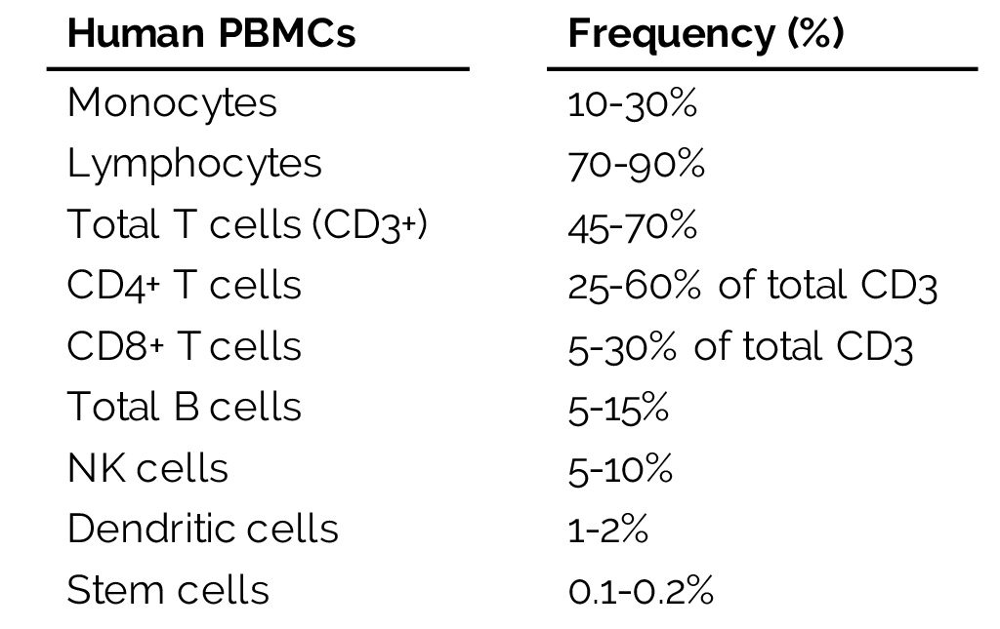

In [5]:
from IPython.display import Image
Image("PBMCs.png")

## 2 Pre-processing and Visualization 

## 2.1 Quality Control 

Data quality control can be split into cell QC and gene QC. Typical quality measures for assessing the quality of a cell include the number of molecule counts (UMIs), the number of expressed genes, and the fraction of counts that are mitochondrial. A high fraction of mitochondrial reads being picked up can indicate cell stress, as there is a low proportion of nuclear mRNA in the cell. It should be noted that high mitochondrial RNA fractions can also be biological signals indicating elevated respiration.

Alternatively, preprocessing can be done somewhere else (such as in R) and then loaded into scanpy. If this is your situation, skip this portion. You can also freeze the raw data at any point if you want to come back to it. Set the .raw attribute of AnnData object to the logarithmized raw gene expression for later use in differential testing and visualizations of gene expression. This simply freezes the state of the AnnData object returned by sc.pp.log1p.

In [6]:
# Quality control - calculate QC covariates
adata.obs['n_counts'] = adata.X.sum(1)
adata.obs['log_counts'] = np.log(adata.obs['n_counts'])
adata.obs['n_genes'] = (adata.X > 0).sum(1)

Citing from “Simple Single Cell” workflows (Lun, McCarthy & Marioni, 2017):

High proportions are indicative of poor-quality cells (Islam et al. 2014; Ilicic et al. 2016), possibly because of loss of cytoplasmic RNA from perforated cells. The reasoning is that mitochondria are larger than individual transcript molecules and less likely to escape through tears in the cell membrane.

In [7]:
mito_genes = adata.var_names.str.startswith('MT-')
# for each cell compute fraction of counts in mito genes vs. all genes
# the `.A1` is only necessary as X is sparse (to transform to a dense array after summing)
adata.obs['percent_mito'] = np.sum(adata[:, mito_genes].X, axis=1).A1 / np.sum(adata.X, axis=1).A1
# add the total counts per cell as observations-annotation to adata
adata.obs['n_counts'] = adata.X.sum(axis=1).A1

In [8]:
adata.obs.head()

,n_counts,log_counts,n_genes,percent_mito
AAACATACAACCAC-1,2421.0,7.791936,781,0.030153
AAACATTGAGCTAC-1,4903.0,8.497602,1352,0.037936
AAACATTGATCAGC-1,3149.0,8.054840,1131,0.008892
AAACCGTGCTTCCG-1,2639.0,7.878155,960,0.017431
AAACCGTGTATGCG-1,981.0,6.888573,522,0.012232


Now lets use a violin plot to take a look at the quality of our data

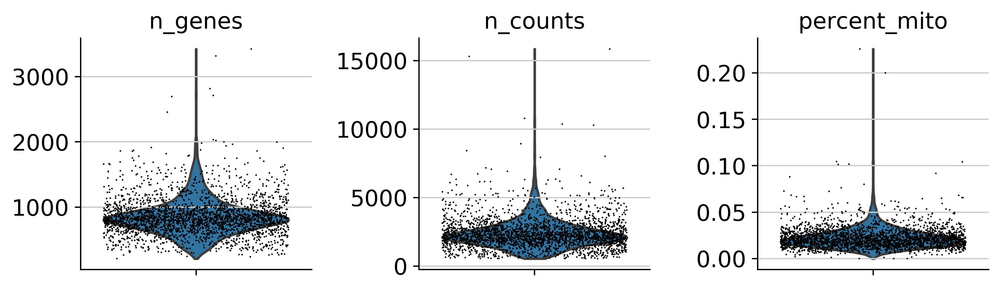

In [9]:
sc.pl.violin(adata, ['n_genes', 'n_counts', 'percent_mito'],jitter=0.4, multi_panel=True, cut=0)

The plots show that the counts per cell is around 2500 and the fraction of mitochondrial reads (MT frac) for most cells are still far below 20-25%, which ishe typical filtering thresholds.

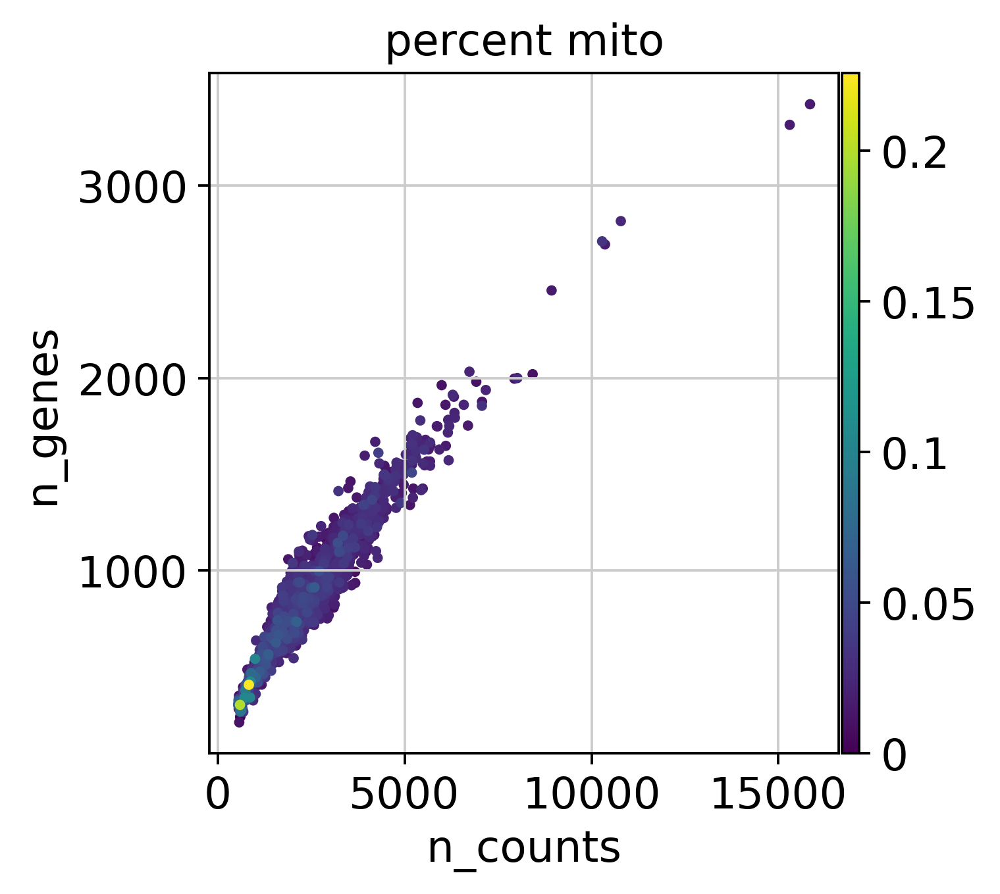

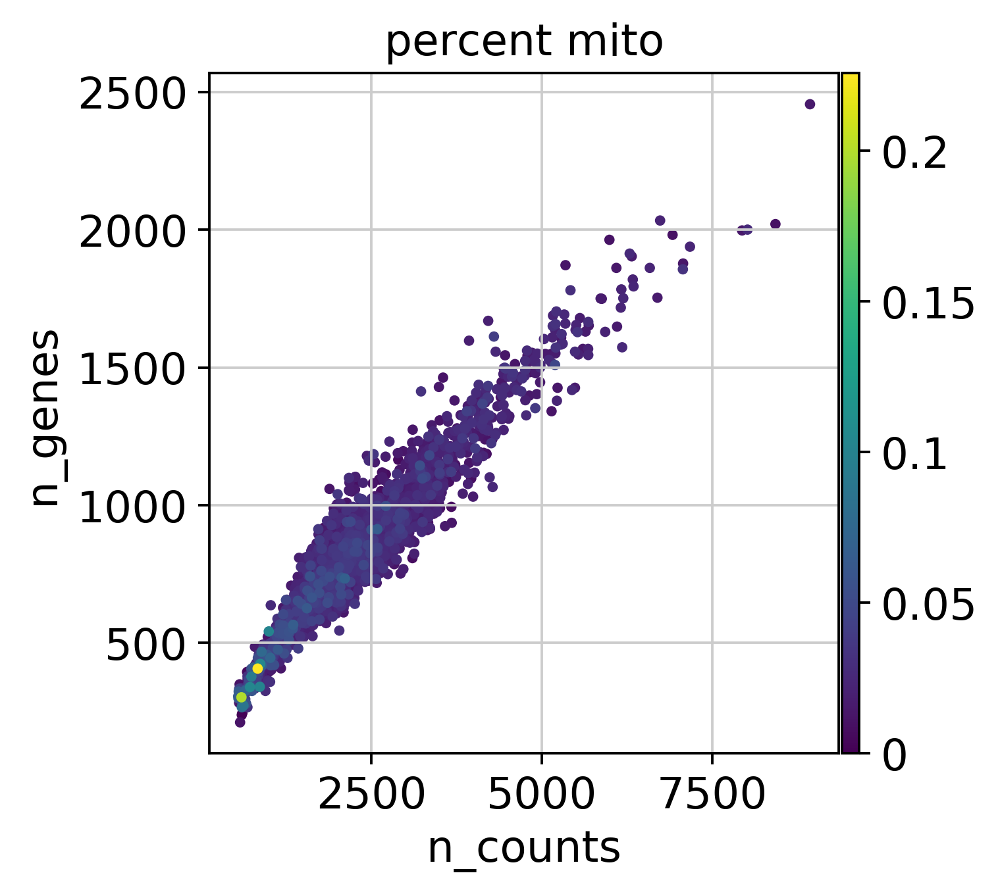

In [10]:
#Data quality summary plots
p1 = sc.pl.scatter(adata, 'n_counts', 'n_genes', color='percent_mito')
p2 = sc.pl.scatter(adata[adata.obs['n_counts']<10000], 'n_counts', 'n_genes', color='percent_mito')

By looking at plots of the number of genes versus the number of counts with MT fraction information, we can assess whether there cells with unexpected summary statistics. It is important here to look at these statistics jointly. For example, there is a cloud of points with many counts, but few genes. Our first instinct would be to filter out these as "dying" outliers, however they don't seem to show high MT fraction. We should probably still filter out some cells with very few genes as these may be difficult to annotate later. This will be true for the initial cellular density between 1000-4000 counts and < ~500 genes.

Furthermore it can be seen in the main cloud of data points, that cells with lower counts and genes tend to have a higher fraction of mitochondrial counts. These cells are likely under stress or are dying. When apoptotic cells are sequenced, there is less mRNA to be captured in the nucleus, and therefore fewer counts overall, and thus a higher fraction of counts fall upon mitochondrial RNA. If cells with high mitochondrial activity were found at higher counts/genes per cell, this would indicate biologically relevant mitochondrial activity.

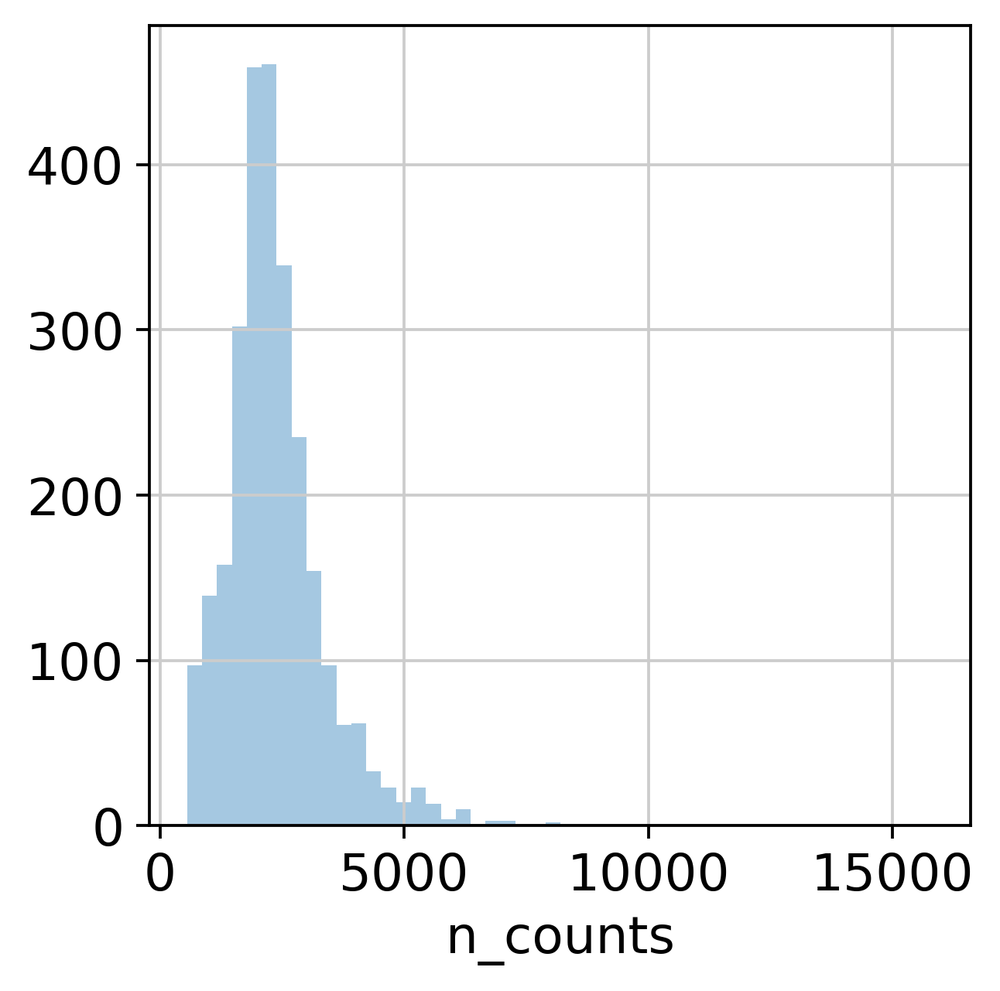

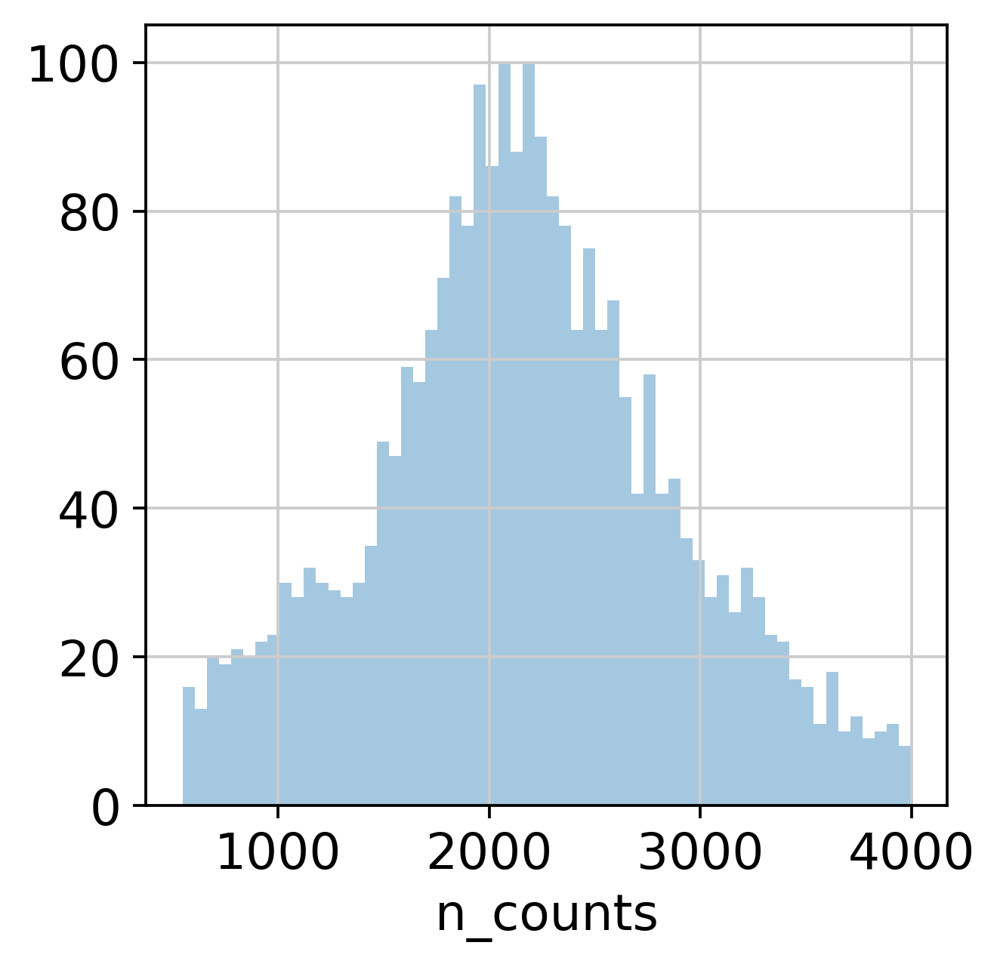

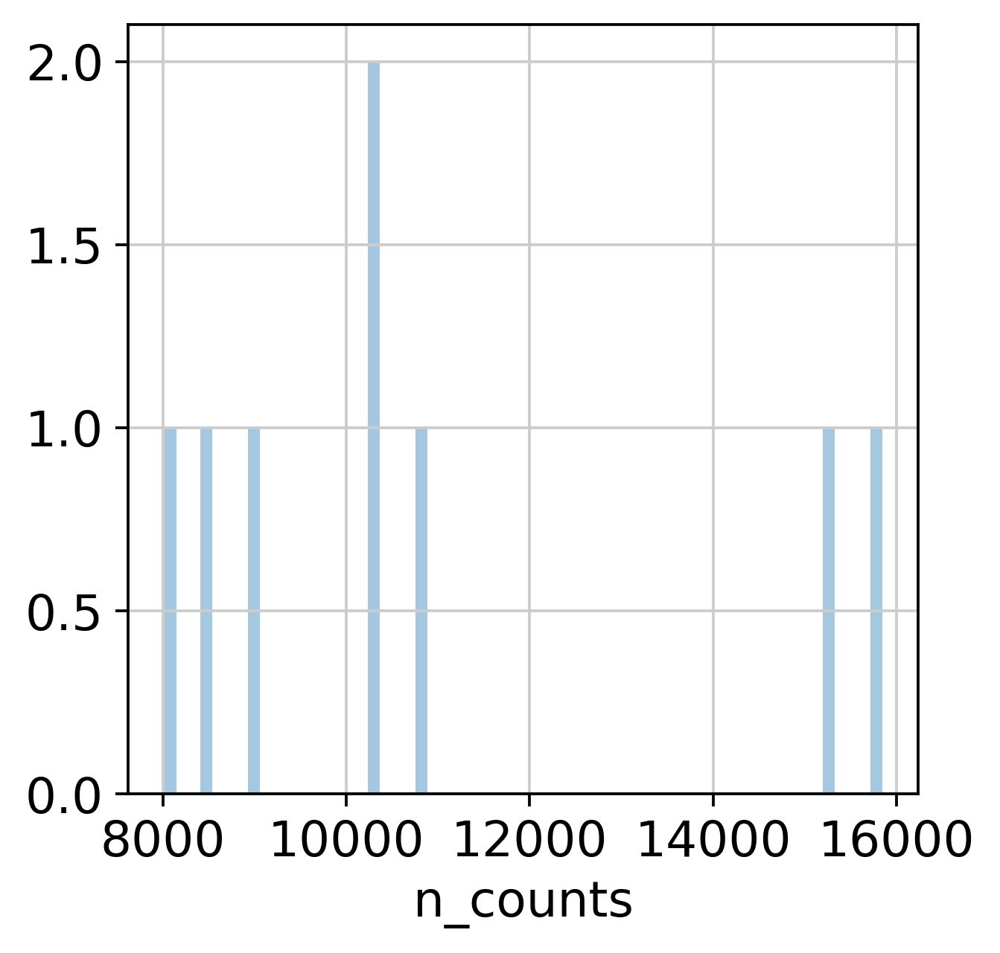

In [11]:
#Thresholding decision: counts
p3 = sb.distplot(adata.obs['n_counts'], kde=False)
plt.show()

p4 = sb.distplot(adata.obs['n_counts'][adata.obs['n_counts']<4000], kde=False, bins=60)
plt.show()

p5 = sb.distplot(adata.obs['n_counts'][adata.obs['n_counts']>8000], kde=False, bins=60)
plt.show()

Histograms of the number of counts per cell show that there are two small peaks of groups of cells with fewer than 1500 counts. which are likely uninformative given the overall distribution of counts. This may be cellular debris found in droplets.

On the upper end of counts, we see just a few cells with counts over 8000.

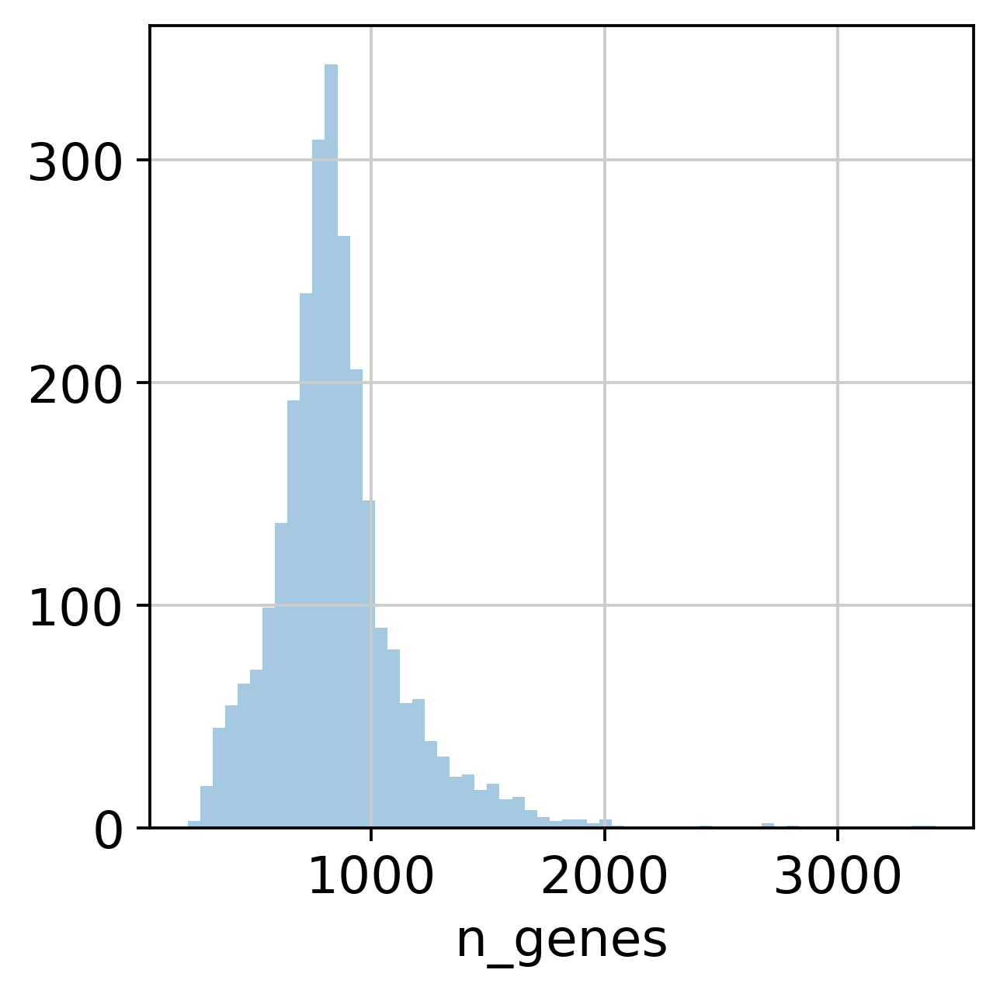

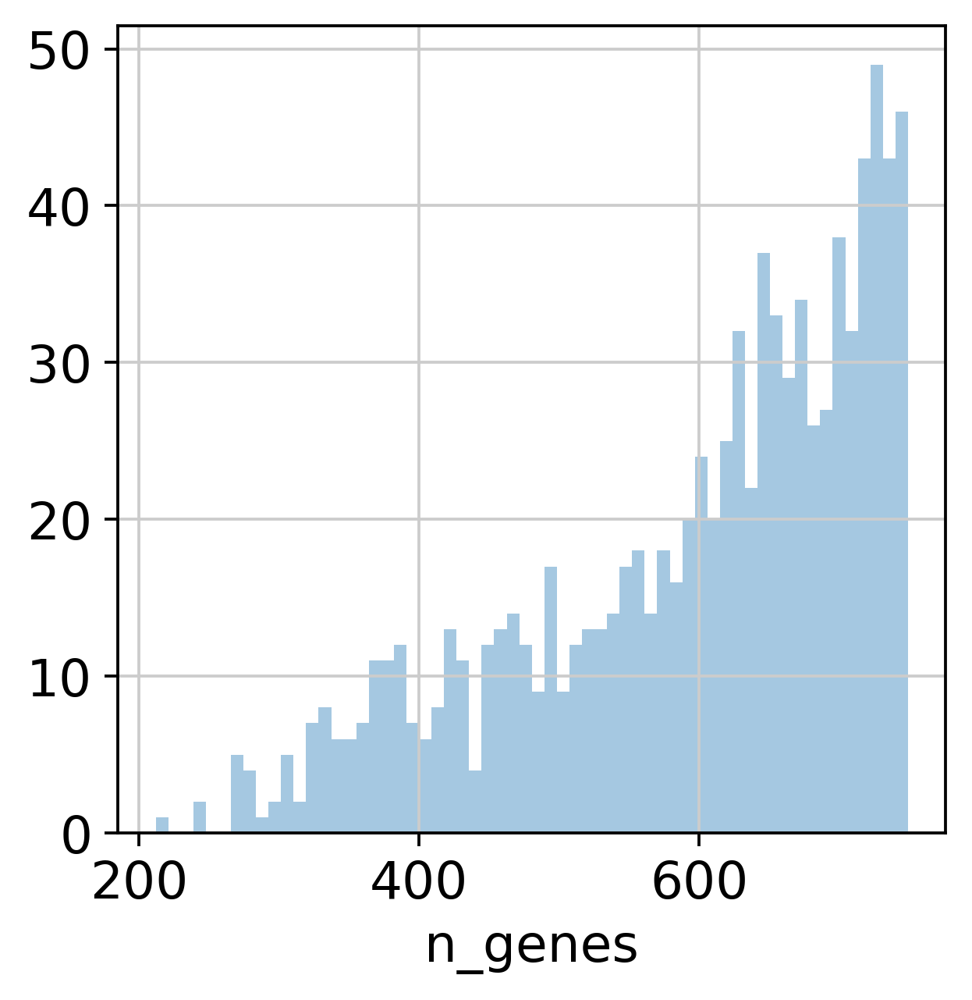

In [12]:
#Thresholding decision: genes
p6 = sb.distplot(adata.obs['n_genes'], kde=False, bins=60)
plt.show()

p7 = sb.distplot(adata.obs['n_genes'][adata.obs['n_genes']<750], kde=False, bins=60)
plt.show()

It looks like our data just has a small population of celss with low gene counts. Not suprisingly, given that this data was taken from the 10X website it is quite clean with very little filtering needed. However, given these plots, and the plot of genes vs counts above, we decide to filter out cells with fewer than 500 genes expressed. Below this we are likely to find dying cells or empty droplets with ambient RNA. Looking above at the joint plots, we see that we filter out the main density of low gene cells with this threshold.

In general it is a good idea to be permissive in the early filtering steps, and then come back to filter out more stringently when a clear picture is available of what would be filtered out. This is available after visualization/clustering. For demonstration purposes we stick to a simple (and slightly more stringent) filtering here.

In [13]:
# Filter cells according to identified QC thresholds:
print('Total number of cells: {:d}'.format(adata.n_obs))

sc.pp.filter_cells(adata, min_counts = 1250)
print('Number of cells after min count filter: {:d}'.format(adata.n_obs))

sc.pp.filter_cells(adata, max_counts = 8000)
print('Number of cells after max count filter: {:d}'.format(adata.n_obs))

adata = adata[adata.obs['percent_mito'] < 0.2]
print('Number of cells after MT filter: {:d}'.format(adata.n_obs))

sc.pp.filter_cells(adata, min_genes = 500)
print('Number of cells after gene filter: {:d}'.format(adata.n_obs))

Total number of cells: 2700
filtered out 280 cells that haveless than 1250 counts
Number of cells after min count filter: 2420
filtered out 8 cells that havemore than 8000 counts
Number of cells after max count filter: 2412
Number of cells after MT filter: 2412
filtered out 4 cells that haveless than 500 genes expressed


Trying to set attribute `.obs` of view, copying.


Number of cells after gene filter: 2408


In [14]:
#Filter genes:
print('Total number of genes: {:d}'.format(adata.n_vars))

# Min 15 cells - filters out 0 count genes
sc.pp.filter_genes(adata, min_cells=15)
print('Number of genes after cell filter: {:d}'.format(adata.n_vars))

Total number of genes: 32738
filtered out 22545 genes that are detectedin less than 15 cells
Number of genes after cell filter: 10193


Genes are also filtered if they are not detected in at least 15 cells. This reduces the dimensions of the matrix by removing 0 count genes and genes which are not sufficiently informative of the dataset. 15 is not a magic number and should be adjusted down or up depending on how many cells are in your dataset.

## 2.2 Normalization

Each count in a count matrix represents the successful capture, reverse transcription and sequencing of a molecule of cellular mRNA. Count depths for identical cells can differ due to the variability inherent in each of these steps. Thus, when gene expression is compared between cells based on count data, any difference may have arisen solely due to sampling effects. Normalization addresses this issue by e.g. scaling count data to obtain correct relative gene expression abundances between cells.

Scanpy has a builtin (scanpy.pp.normalize_total) which normalizes the counts per cell. If we choose target_sum=1e6, this is CPM normalization. CPM normalization is the most commonly used normalization protocol and is also referred to as “counts per million”. This protocol comes from bulk expression analysis and normalizes count data using a so-called size factor proportional to the count depth per cell. Variations of this method scale the size factors with different factors of 10, or by the median count depth per cell in the dataset. CPM normalization assumes that all cells in the dataset initially contained an equal number of mRNA molecules and count depth differences arise only due to sampling. If target_sum=None, after normalization, each observation (cell) has a total count equal to the median of total counts for observations (cells) before normalization 

If exclude_highly_expressed=True, very highly expressed genes are excluded from the computation of the normalization factor (size factor) for each cell. This is meaningful as these can strongly influence the resulting normalized values for all other genes [Weinreb17]

We will use this normalization for our data today because we have limited cellular variability in our data and due to the time and effort it takes to set up SCRAN, but it is probably not the best method to use.

**Important: Before normalizing the data, we ensure that a copy of the raw count data is kept in a separate AnnData object. This allows us to use methods downstream that require this data as input.**

In [15]:
#Keep the count data in a counts layer
adata.layers["counts"] = adata.X.copy()

In [16]:
#Normalize the data and log transform it
sc.pp.normalize_per_cell(adata)
sc.pp.log1p(adata)

normalizing by total count per cell
    finished (0:00:00): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


In [17]:
# Store the full data set in 'raw' as log-normalised data for statistical testing
adata.raw = adata

The count data has been normalized and log-transformed with an offset of 1. The latter is performed to normalize the data distributions. The offset of 1 ensures that zero counts map to zeros. We keep this data in the '.raw' part of the AnnData object as it will be used to visualize gene expression and perform statistical tests such as computing marker genes for clusters.

## Aside: Using SCRAN on your own data

As we cannot assume that all cells contain an equal number of molecules (cell sizes can differ substantially), we have to estimate the number of molecules that were initially in the cells. In fact, we don't estimate the exact number of molecules, but instead estimate cell-specific factors that should be proportional to the true number of molecules. These are called size factors. Normalized expression values are calculated by dividing the measured counts by the size factor for the cell.

Based on comparisons of normalization methods for differential testing, and batch correction [Buettner et al., 2019], the normalization method implemented in the scran package performs best. This method requires a coarse clustering input to improve size factor esimation performance. Thus, we use a simple preprocessing approach and cluster the data at a low resolution to get an input for the size factor estimation. The basic preprocessing includes assuming all size factors are equal (library size normalization to counts per million - CPM) and log-transforming the count data.

First we need to import R for using in our python notebook and import all of the R packages that we need

In [18]:
import rpy2.rinterface_lib.callbacks
import logging

from rpy2.robjects import pandas2ri
import anndata2ri
import rpy2.rinterface_lib.callbacks
import logging

from rpy2.robjects import pandas2ri
import anndata2ri
# Automatically convert rpy2 outputs to pandas dataframes
pandas2ri.activate()
anndata2ri.activate()
%load_ext rpy2.ipython

plt.rcParams['figure.figsize']=(8,8) #rescale figures
#sc.set_figure_params(dpi=200, dpi_save=300)
sc.logging.print_versions()

scanpy==1.4.4.post1 anndata==0.7.1 umap==0.3.10 numpy==1.18.1 scipy==1.4.1 pandas==0.24.1 scikit-learn==0.21.3 statsmodels==0.9.0 python-igraph==0.7.1 louvain==0.6.1


In [19]:
%%R

# Load all the R libraries we will be using in the notebook
library(scran)
library(RColorBrewer)
library(slingshot) #not needed for normalization but is a trajectory inference package used later on
library(monocle) #not needed for normalization but is a trajectory inference package used later on
library(gam) #not needed for normalization but is a gene expression dynamics package used later on
library(clusterExperiment) #not needed for normalization but is a gene expression dynamics package used later on
library(ggplot2)
library(plyr)
library(MAST) #not needed for normalization but is a differential expression package used later on

R[write to console]: Loading required package: SingleCellExperiment

R[write to console]: Loading required package: SummarizedExperiment

R[write to console]: Loading required package: GenomicRanges

R[write to console]: Loading required package: stats4

R[write to console]: Loading required package: BiocGenerics

R[write to console]: Loading required package: parallel

R[write to console]: 
Attaching package: ‘BiocGenerics’


R[write to console]: The following objects are masked from ‘package:parallel’:

    clusterApply, clusterApplyLB, clusterCall, clusterEvalQ,
    clusterExport, clusterMap, parApply, parCapply, parLapply,
    parLapplyLB, parRapply, parSapply, parSapplyLB


R[write to console]: The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


R[write to console]: The following objects are masked from ‘package:base’:

    anyDuplicated, append, as.data.frame, basename, cbind, colnames,
    dirname, do.call, duplicated, eval, evalq, Filter, Find

In [20]:
'''#Perform a clustering for scran normalization in clusters
adata_pp = adata.copy()
sc.pp.normalize_per_cell(adata_pp, counts_per_cell_after=1e6)
sc.pp.log1p(adata_pp)
sc.pp.pca(adata_pp, n_comps=15)
sc.pp.neighbors(adata_pp)
sc.tl.louvain(adata_pp, key_added='groups', resolution=0.5)'''

"#Perform a clustering for scran normalization in clusters\nadata_pp = adata.copy()\nsc.pp.normalize_per_cell(adata_pp, counts_per_cell_after=1e6)\nsc.pp.log1p(adata_pp)\nsc.pp.pca(adata_pp, n_comps=15)\nsc.pp.neighbors(adata_pp)\nsc.tl.louvain(adata_pp, key_added='groups', resolution=0.5)"

In [21]:
'''#Preprocess variables for scran normalization
input_groups = adata_pp.obs['groups']
data_mat = adata.X.T'''

"#Preprocess variables for scran normalization\ninput_groups = adata_pp.obs['groups']\ndata_mat = adata.X.T"

In [22]:
'''%%R -i data_mat -i input_groups -o size_factors

size_factors = computeSumFactors(data_mat, clusters=input_groups, min.mean=0.1)'''

'%%R -i data_mat -i input_groups -o size_factors\n\nsize_factors = computeSumFactors(data_mat, clusters=input_groups, min.mean=0.1)'

In [23]:
'''#Delete adata_pp
del adata_pp'''

'#Delete adata_pp\ndel adata_pp'

In [24]:
'''# Visualize the estimated size factors
adata.obs['size_factors'] = size_factors

sc.pl.scatter(adata, 'size_factors', 'n_counts')
sc.pl.scatter(adata, 'size_factors', 'n_genes')

sb.distplot(size_factors, bins=50, kde=False)
plt.show()'''

"# Visualize the estimated size factors\nadata.obs['size_factors'] = size_factors\n\nsc.pl.scatter(adata, 'size_factors', 'n_counts')\nsc.pl.scatter(adata, 'size_factors', 'n_genes')\n\nsb.distplot(size_factors, bins=50, kde=False)\nplt.show()"

In [25]:
'''#Normalize adata 
adata.X /= adata.obs['size_factors'].values[:,None]
sc.pp.log1p(adata)'''

"#Normalize adata \nadata.X /= adata.obs['size_factors'].values[:,None]\nsc.pp.log1p(adata)"

## 2.3 Batch Correction

Batch correction is performed to adjust for batch effects from the different samples that you might load together. Our dataset is one patients PBMCs so in our case we do not have to batch correct. However, if we had multiple tissue samples that were being combined together we would want to correct for any batch effects. As the batch effect from samples are often overlapping, correcting for this batch effect will also partially regress out differences between regions. We allow for this to optimally cluster the data. This approach can also be helpful to find differentiation trajectories, but we revert back to non-batch-corrected data for differential testing and computing marker genes.

Note that ComBat batch correction requires a dense matrix format as input (which is already the case in this example).

If we wanted to batch correct we would perform the below:

In [26]:
'''# ComBat batch correction
sc.pp.combat(adata, key='sample')'''
#where "sample" is some batch we want to correct for. We would set this up when we load the data.

"# ComBat batch correction\nsc.pp.combat(adata, key='sample')"

Note ComBat batch correction can produce negative expression values. One can either set all negative values to 0 or force zeros pre-batch-correction to remain zero post-batch-correction.

## 2.4 Highly Variable Genes

We extract highly variable genes (HVGs) to further reduce the dimensionality of the dataset and include only the most informative genes. Genes that vary substantially across the dataset are informative of the underlying biological variation in the data. As we only want to capture biological variation in these genes, we select highly variable genes after normalization and batch correction. **HVGs are used for clustering, trajectory inference, and dimensionality reduction/visualization, while the full data set is used for computing marker genes, differential testing, cell cycle scoring, and visualizing expression values on the data.**

In [27]:
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=4, min_disp=0.5)

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


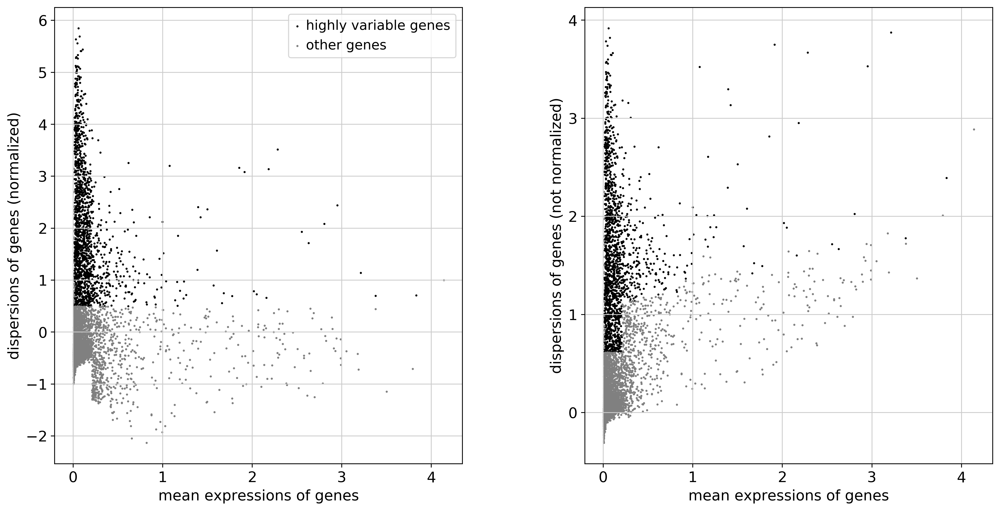

In [28]:
sc.pl.highly_variable_genes(adata)

Alternatively, we could use the standard technique for the extraction of highly variable genes from the 10X genomics preprocessing software CellRanger. Typically between 1000 and 5000 genes are selected. Here, we extract the top 2000 most variable genes for further processing. If particular genes of importance are known, one could assess how many highly variable genes are necessary to include all, or the majority, of these

In [29]:
'''sc.pp.highly_variable_genes(adata, flavor='cell_ranger', n_top_genes=4000)
print('\n','Number of highly variable genes: {:d}'.format(np.sum(adata.var['highly_variable'])))'''

"sc.pp.highly_variable_genes(adata, flavor='cell_ranger', n_top_genes=4000)\nprint('\n','Number of highly variable genes: {:d}'.format(np.sum(adata.var['highly_variable'])))"

The plots show how the data was normalized to select highly variable genes irrespective of the mean expression of the genes unless  you set a maximum. This is achieved by using the index of dispersion which divides by mean expression, and subsequently binning the data by mean expression and selecting the most variable genes within each bin.

Highly variable gene information is stored automatically in the adata.var['highly_variable'] field. The dataset now contains:

- a 'counts' layer with count data
- log-normalized data in adata.raw
- highly variable gene annotations in adata.var['highly_variable']

The HVG labels will be used to subselect genes for clustering and trajectory analysis.

In [30]:
adata

AnnData object with n_obs × n_vars = 2408 × 10193 
    obs: 'n_counts', 'log_counts', 'n_genes', 'percent_mito'
    var: 'gene_ids', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    layers: 'counts'

## 2.5 Dimenstionality Reduction Methods: Visualization and Summarization

There are two main objectives of dimensionality reduction methods: visualization and summarization. Visualization is the attempt to optimally describe the dataset in two or three dimensions. These reduced dimensions are used as coordinates on a scatter plot to obtain a visual representation of the data. Summarization does not prescribe the number of output components. Instead, higher components become less important for describing the variability present in the data. Summarization techniques can be used to reduce the data to its essential components by finding the inherent dimensionality of the data, and are thus helpful for downstream analysis.


Visualizing scRNA-seq data is the process of projecting a high-dimensional matrix of cells and genes into a few coordinates such that every cell is meaningfully represented in a two-dimensional graph. However, the visualization of scRNA-seq data is an active area of research and each method defines 'meaningful' in its own way. Thus, it is a good idea to look at several visualizations and decide which visualization best represents the aspect of the data that is being investigated.

Overall t-SNE visualizations have been very popular in the community, however the recent UMAP algorithm has been shown to better represent the topology of the data.

Note that we do not scale the genes to have zero mean and unit variance. A lack of rescaling is equivalent to giving genes with a higher mean expression a higher weight in dimensionality reduction (despite correcting for mean offsets in PCA, due to the mean-variance relationship). We argue that this weighting based on mean expression being a biologically relevant signal. However, rescaling HVG expression is also common, and the number of publications that use this approach suggests that scaling is at least not detrimental to downstream scRNA-seq analysis.


In [31]:
# Calculate the visualizations
sc.pp.pca(adata, n_comps=50, use_highly_variable=True, svd_solver='arpack')
sc.pp.neighbors(adata)

sc.tl.tsne(adata, n_jobs=12) #Note n_jobs works for MulticoreTSNE, but not regular implementation)
sc.tl.umap(adata)
sc.tl.diffmap(adata)
sc.tl.draw_graph(adata)

computing PCA with n_comps = 50
computing PCA on highly variable genes
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:02)
computing tSNE
    using 'X_pca' with n_pcs = 50
    using the 'MulticoreTSNE' package by Ulyanov (2017)
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:08)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:06)
computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.99957246 0.9953811  0.98750466 0.97887474 0.95731485
     0.9494967  0.9036237  0.89454955 0.8702341  0.84665316 0.8376605
     0.82100457 0.8095188  0.79180837]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition 

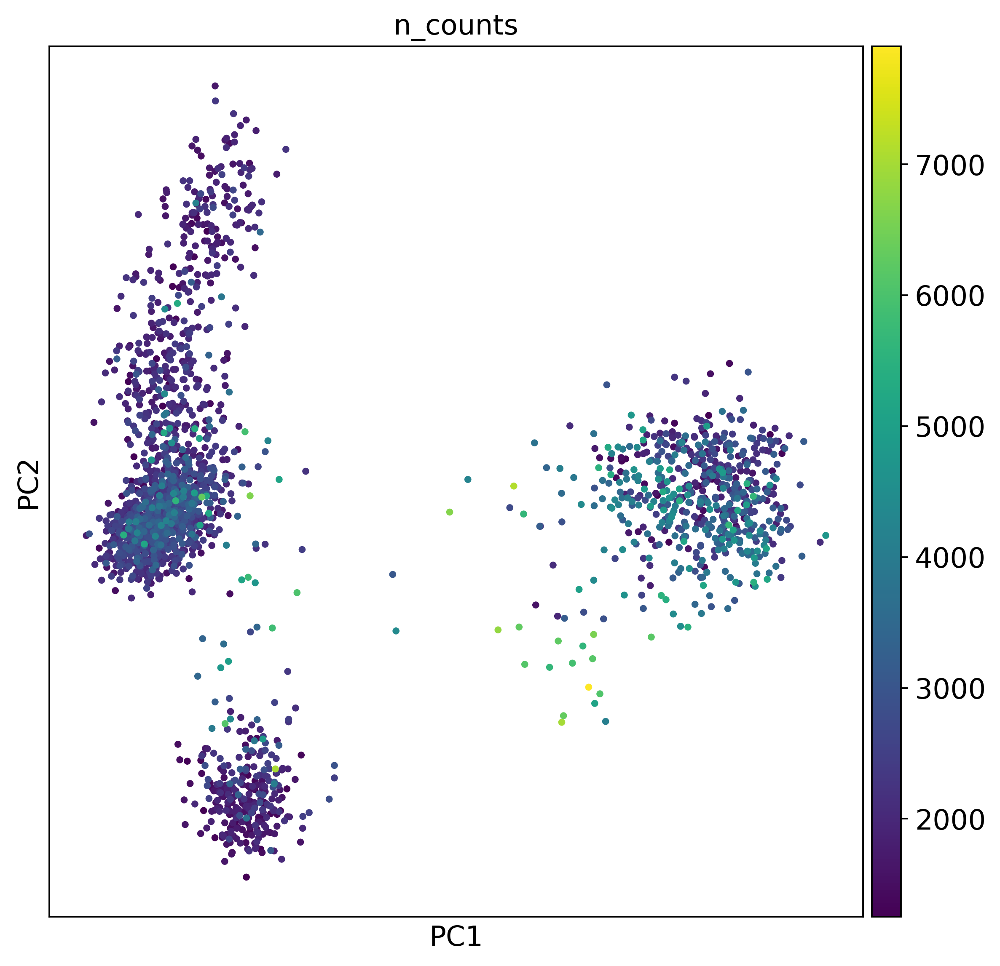

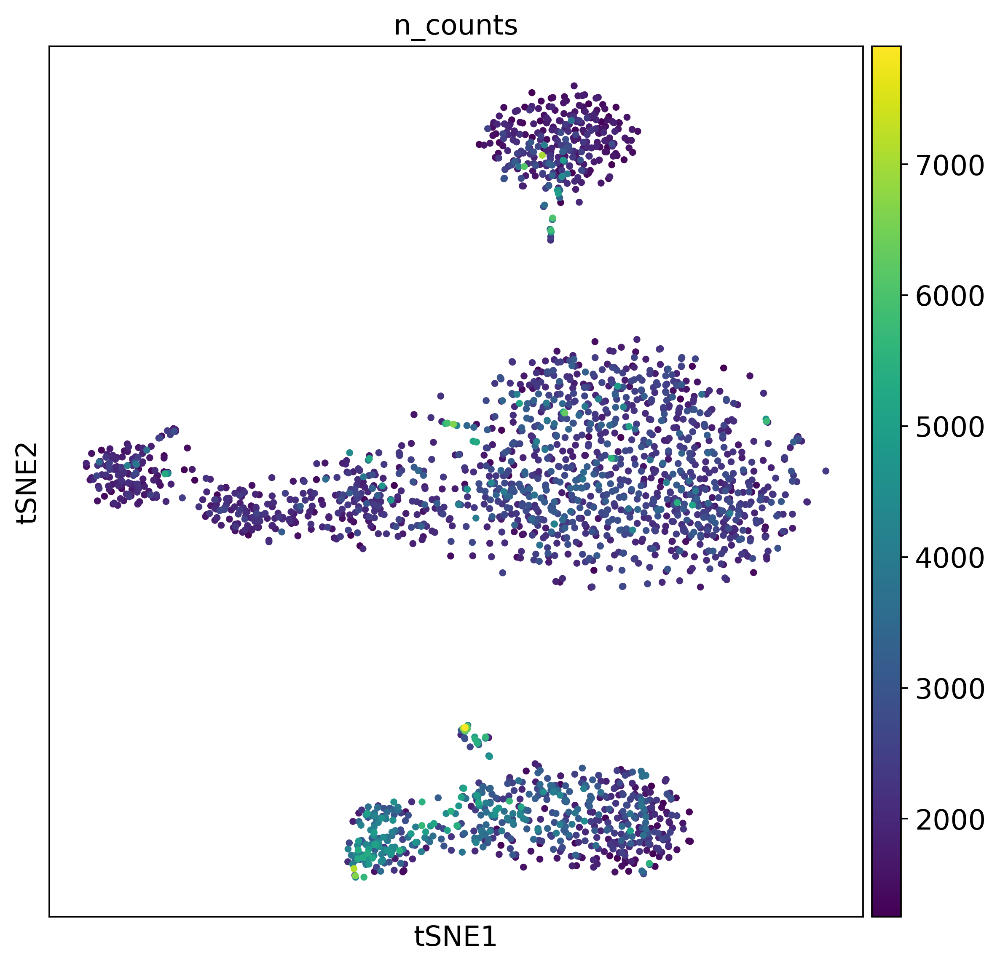

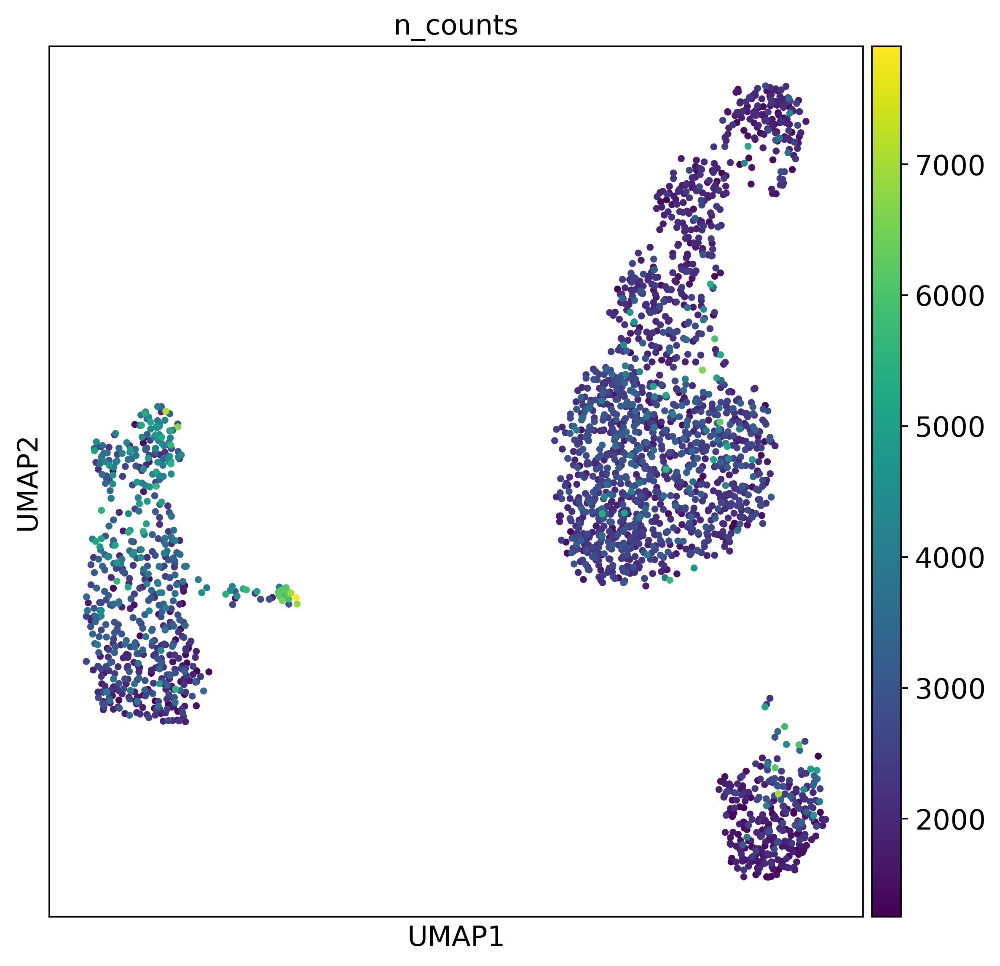

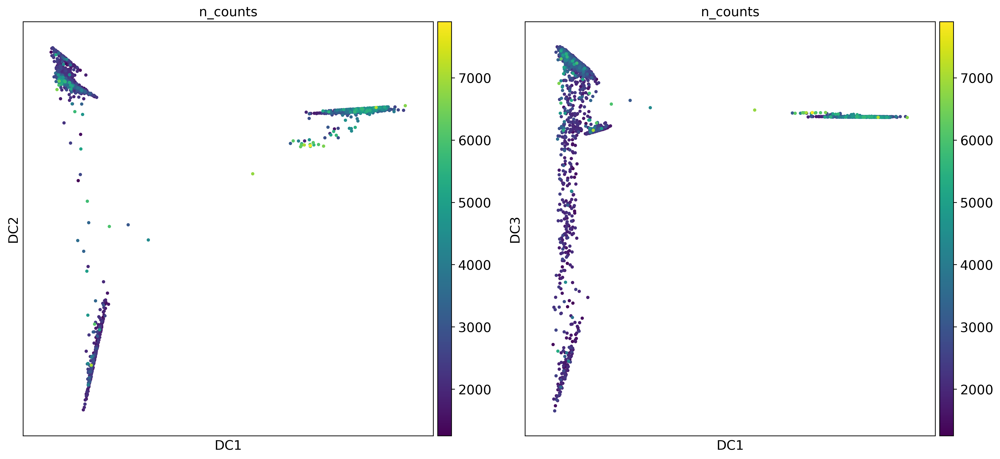

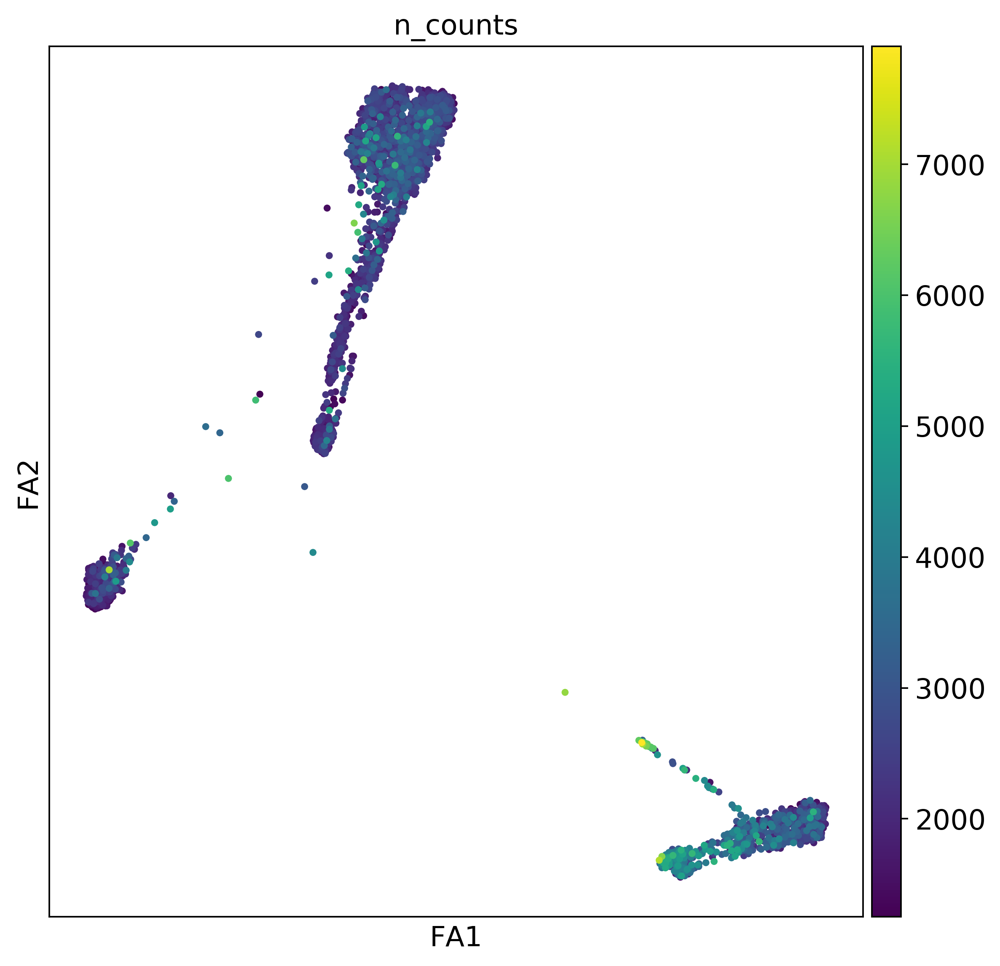

In [32]:
sc.pl.pca_scatter(adata, color='n_counts')
sc.pl.tsne(adata, color='n_counts')
sc.pl.umap(adata, color='n_counts')
sc.pl.diffmap(adata, color='n_counts', components=['1,2','1,3'])
sc.pl.draw_graph(adata, color='n_counts')

PCA:
- Unsurprisingly, the first principle component captures variation in count depth between cells, and is thus only marginally informative
- The plot usually will not show the expected clustering of the data in two dimensions unless your data is not very heterogenous as ours is

t-SNE:
- Shows several distinct clusters with clear subcluster structure
- Connections between clusters are difficult to interpret visually

UMAP:
- Data points are spread out on the plot showing several clusters
- Connections between clusters can be readily identified

Diffusion Maps:
- Shows connections between regions of higher density
- Very clear trajectories are suggested, but clusters are less clear
- Each diffusion component extracts heterogeneity in a different part of the data

Graph:
- Does not show much new information when compared to the others but often will show clear connections between the clusters and hint at stem cell clusters

The strengths and weaknesses of the visualizations might not be readily identified in the above plots. However, generally t-SNE exaggerates differences (but sacrafices accurate global distance representation in favor of local distance), diffusion maps exaggerate transitions. Overall UMAP and force-directed graph drawings show the best compromise of the two aspects, however UMAP is much faster to compute (8s vs 114s here). UMAP has furthermore been shown to more accurately display the structure in the data.

## 2.6 Cell Cycle Scoring

So far we have tried to correct for known sources of technical variation in the data (e.g. batch, count depth). There are also known sources of biological variation that can explain the data and also can be corrected for (e.g. cell cycle). This data correction can be performed by a simple linear regression against a cell cycle score as implemented in the Scanpy and Seurat platforms (Butler et al, 2018; Wolf et al, 2018) or in specialized packages with more complex mixture models such as scLVM (Buettner et al, 2015) or f-scLVM (Buettner et al, 2017). Lists of marker genes to compute cell cycle scores are obtained from the literature (Macosko et al, 2015). These methods can also be used to regress out other known biological effects such as mitochondrial gene expression, which is interpreted as an indication of cell stress. Several aspects should be considered prior to correcting data
for biological effects. Firstly, correcting for biological covariates is not always helpful to interpret scRNA-seq data. While removing cell cycle effects can improve the inference of developmental trajectories (Buettner et al, 2015; Vento-Tormo et al, 2018), cell cycle signals can also be informative of the biology. 

Here, we will use a gene list from Macosko et al., Cell (2015) to score the cell cycle effect in the data and classify cells by cell cycle phase. Please note, the gene list was generated for human HeLa cells. We perform cell cycle scoring on the full batch-corrected data set in adata.

In [33]:
#Score cell cycle and visualize the effect:
cc_genes = pd.read_table('./Macosko_cell_cycle_genes.txt', delimiter='\t')
s_genes = cc_genes['S'].dropna()
g2m_genes = cc_genes['G2.M'].dropna()

s_genes_ens = adata.var_names[np.in1d(adata.var_names, s_genes)] #in1d = Test whether each element of a 1-D array is also present in a second array
g2m_genes_ens = adata.var_names[np.in1d(adata.var_names, g2m_genes)]

sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes_ens, g2m_genes=g2m_genes_ens)

calculating cell cycle phase
computing score 'S_score'


/home/rmorey/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: FutureWarning: read_table is deprecated, use read_csv instead.
  


    finished: added
    'S_score', score of gene set (adata.obs) (0:00:00)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs) (0:00:00)
-->     'phase', cell cycle phase (adata.obs)


... storing 'phase' as categorical


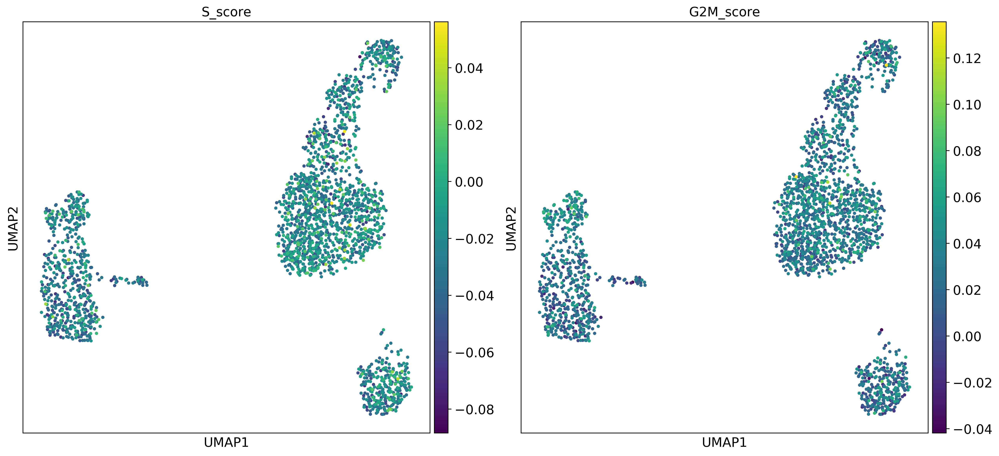

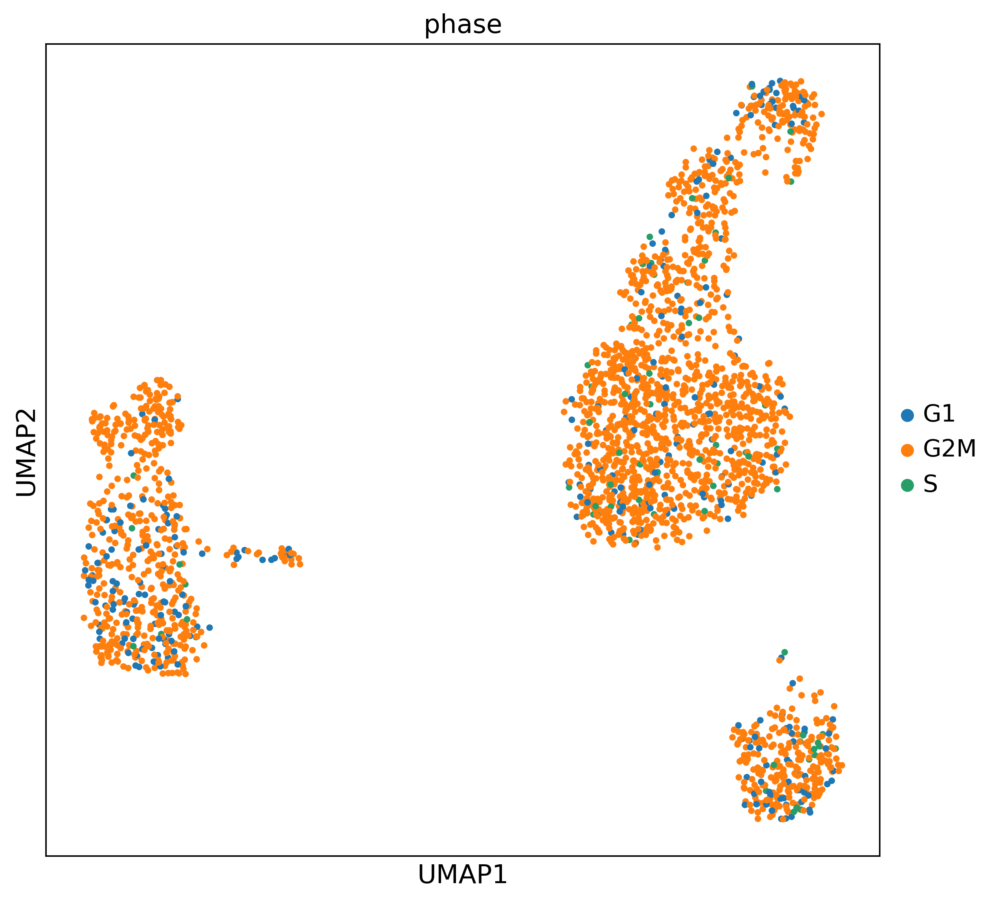

In [34]:
sc.pl.umap(adata, color=['S_score', 'G2M_score'], use_raw=False)
sc.pl.umap(adata, color='phase', use_raw=False)

None of our clusters show a pronounced proliferation signal (probably because they are in the process of dying).

# 3 Downstream analysis

## 3.1 Clustering

Clustering is a central component of the scRNA-seq analysis pipeline. To understand the data, we must identify cell types and states present. The first step of doing so is clustering. Performing Modularity optimization by Louvain community detection on the k-nearest-neighbour graph of cells has become an established practice in scRNA-seq analysis. Thus, this is the method of choice in this tutorial as well.

Here, we perform clustering at two resolutions. Investigating several resolutions allows us to select a clustering that appears to capture the main clusters in the visualization and can provide a good baseline for further subclustering of the data to identify more specific substructure.

Clustering is performed on the highly variable gene data, dimensionality reduced by PCA, and embedded into a KNN graph. (see sc.pp.pca() and sc.pp.neighbors() functions used in the visualization section.


Modularity optimization via louvain has a stochastic element to it. This stochasticity typically does not affect the biological interpretation of the data, but can change the details of analysis scripts. Normally scanpy fixes the random seed to 0 to make scripts exactly reproducible.

In [35]:
sc.tl.louvain(adata, key_added='louvain_r1')
sc.tl.louvain(adata, resolution=0.5, key_added='louvain_r0.5')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 8 clusters and added
    'louvain_r1', the cluster labels (adata.obs, categorical) (0:00:00)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 5 clusters and added
    'louvain_r0.5', the cluster labels (adata.obs, categorical) (0:00:00)


In [36]:
adata.obs['louvain_r0.5'].value_counts()

0    1077
1     601
2     295
3     287
4     148
Name: louvain_r0.5, dtype: int64

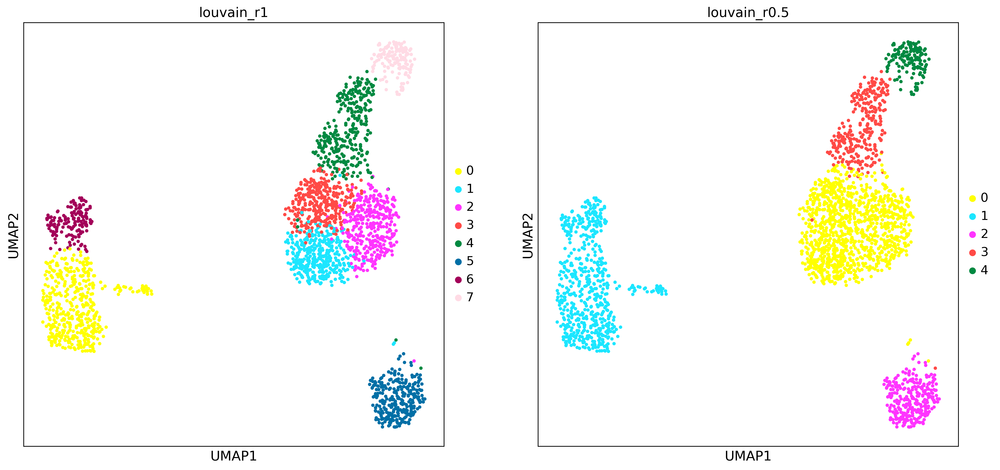

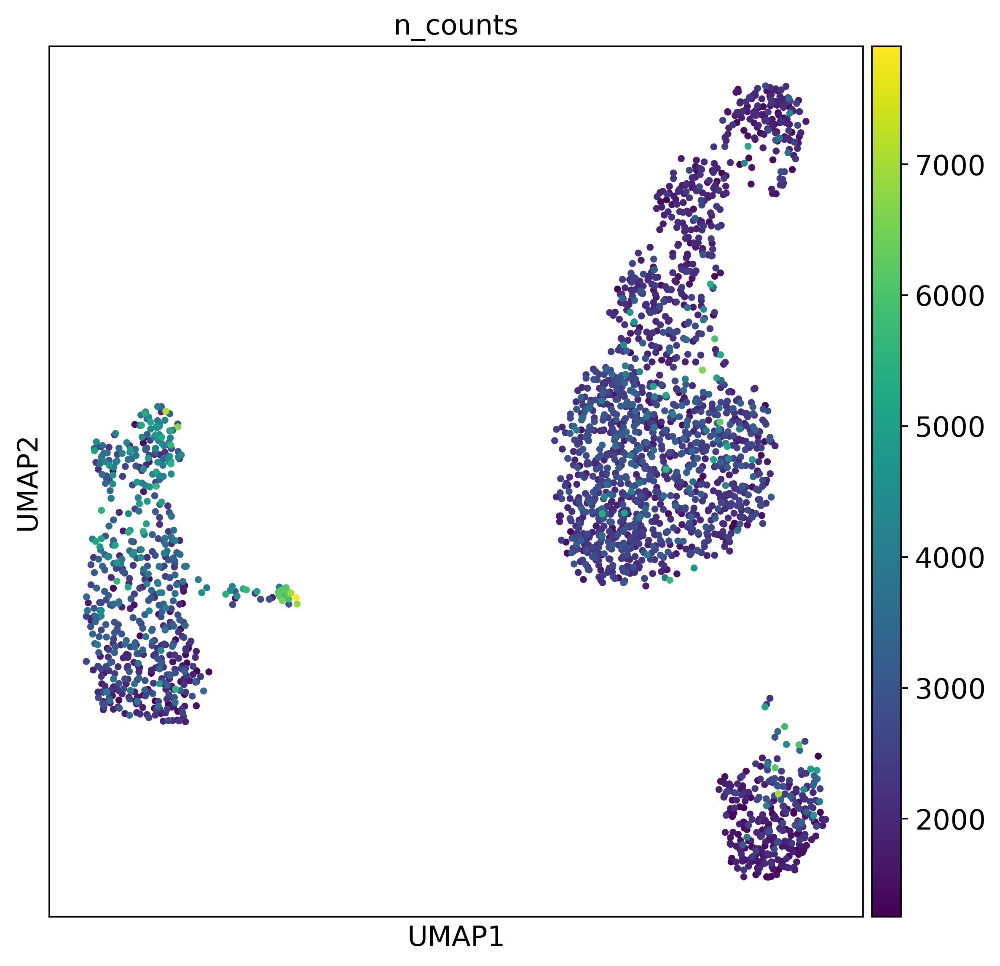

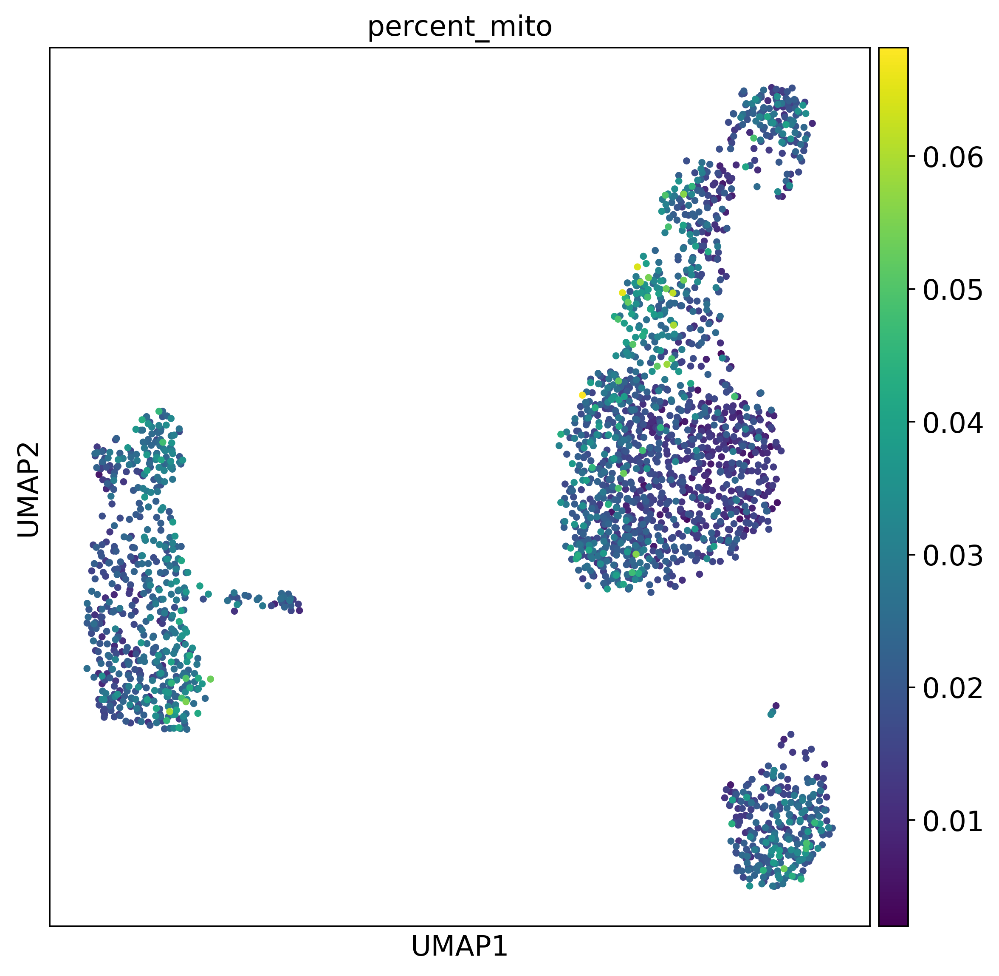

In [37]:
#Visualize the clustering and how this is reflected by different technical covariates
sc.pl.umap(adata, color=['louvain_r1', 'louvain_r0.5'], palette=sc.pl.palettes.default_64)
sc.pl.umap(adata, color=['n_counts'])
sc.pl.umap(adata, color=['percent_mito'])

At a resolution of 0.5 the broad clusters in the visualization are captured well in the data. It remanins to be seen if cluster 1 in the 0.5 resolution should be two clusters instead of one. The covariate plots show that none of the clusters have unusually high or low counts or high percent mitochondria so none of the clusters seem to represent stressed or dying cells.

## 3.2 Marker genes & cluster annotation 

To annotate the clusters we obtained, we find genes that are up-regulated in the cluster compared to all other clusters (marker genes). This differential expression test is performed by a Welch t-test with overestimated variance to be conservative. This is the default in scanpy. The test is automatically performed on the .raw data set, which is uncorrected and contains all genes. All genes are taken into account, as any gene may be an informative marker.

We can use some known marker genes to annotate the clusters and if we didn't have any information on the cells in question we could run automated annotation using scmap or garnett.

In [38]:
#Calculate marker genes
sc.tl.rank_genes_groups(adata, groupby='louvain_r0.5', key_added='rank_genes_r0.5')

ranking genes
    finished: added to `.uns['rank_genes_r0.5']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


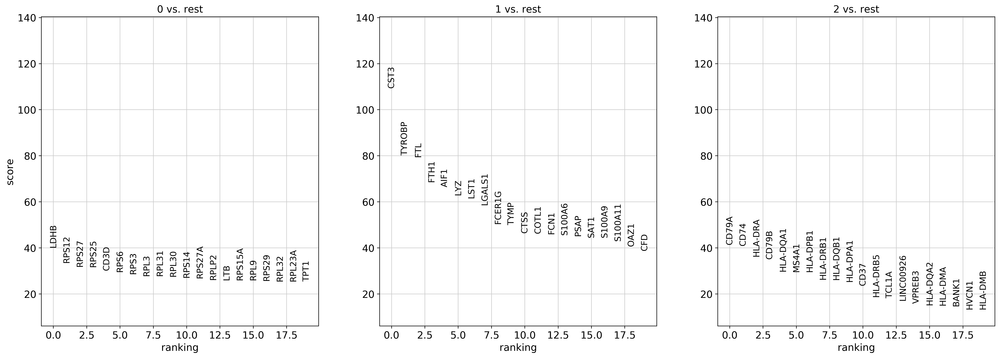

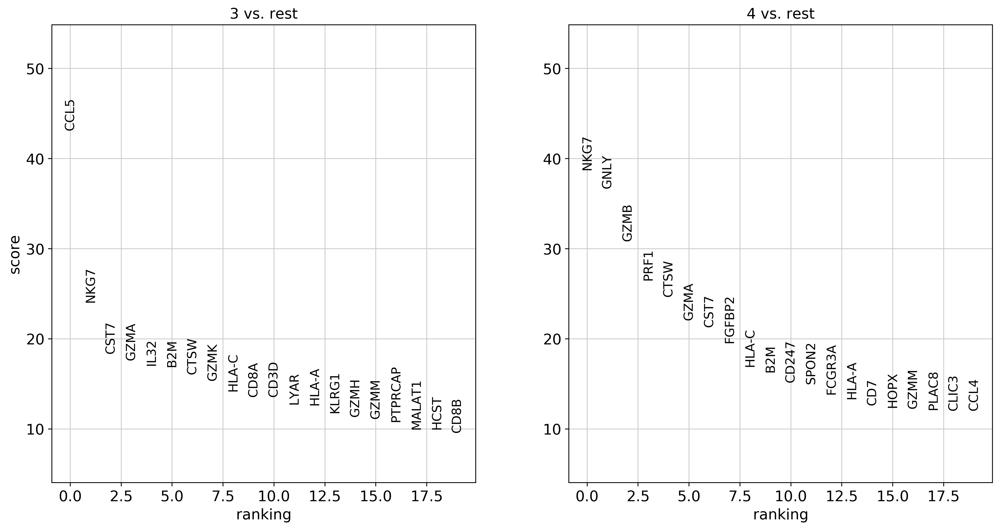

In [39]:
#Plot marker genes
sc.pl.rank_genes_groups(adata, key='rank_genes_r0.5', groups=['0','1','2'], fontsize=12)
sc.pl.rank_genes_groups(adata, key='rank_genes_r0.5', groups=['3','4'], fontsize=12)

Cluster 3 and 4 share quite a few "marker genes" so instead of finding highly expressed genes in these clusters vs all of the other clusters we can ask what genes are highly expressed in cluster 3 compared to just cluster 4 and vice versa.

In [40]:
sc.tl.rank_genes_groups(adata,groupby='louvain_r0.5',groups=['3'],reference='4',key_added='rank_genes_r0.5_clust3')

ranking genes
    finished: added to `.uns['rank_genes_r0.5_clust3']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


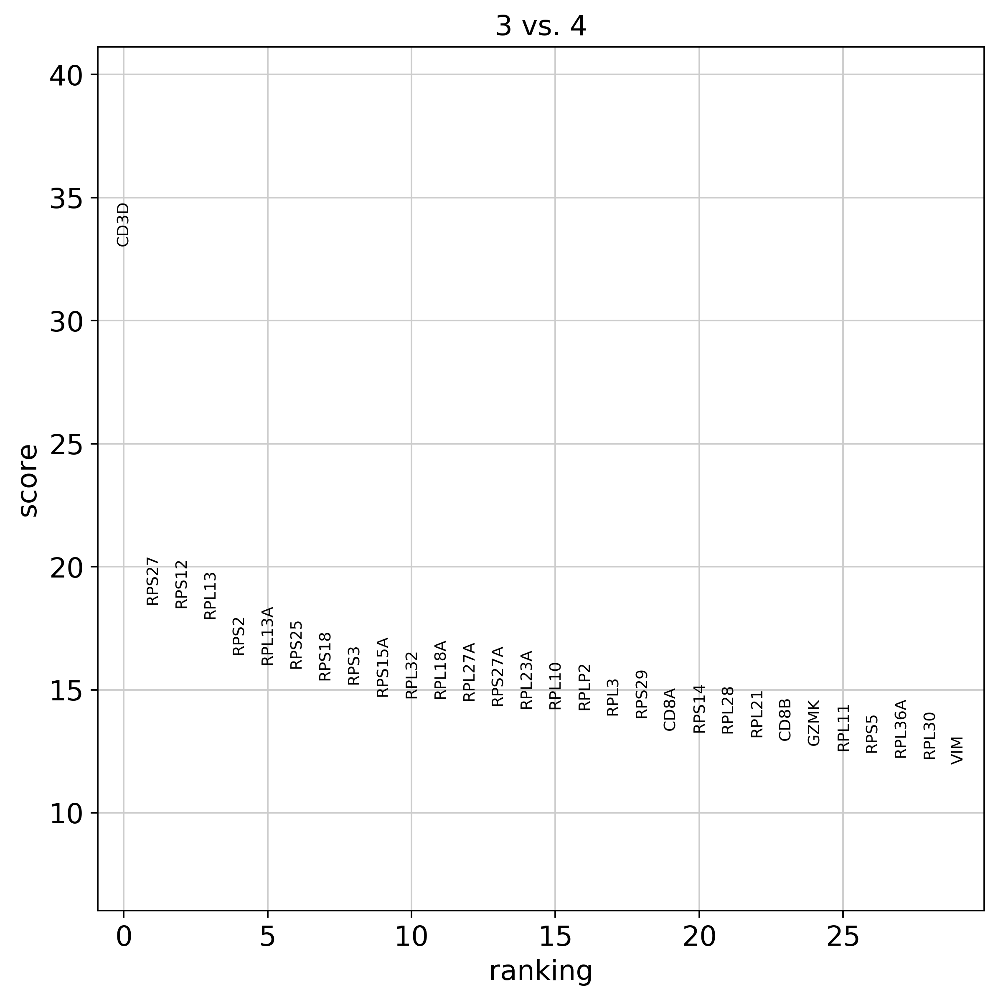

In [41]:
sc.pl.rank_genes_groups(adata, key='rank_genes_r0.5_clust3', groups=['3'], n_genes=30, sharey=False)

To make things easier to look at we can put the top 20 genes in a table

In [42]:
pd.DataFrame(adata.uns['rank_genes_r0.5']['names']).head(20)

,0,1,2,3,4
0,LDHB,CST3,CD79A,CCL5,NKG7
1,RPS12,TYROBP,CD74,NKG7,GNLY
2,RPS27,FTL,HLA-DRA,CST7,GZMB
3,RPS25,FTH1,CD79B,GZMA,PRF1
4,CD3D,AIF1,HLA-DQA1,IL32,CTSW
5,RPS6,LYZ,MS4A1,B2M,GZMA
6,RPS3,LST1,HLA-DPB1,CTSW,CST7
7,RPL3,LGALS1,HLA-DRB1,GZMK,FGFBP2
8,RPL31,FCER1G,HLA-DQB1,HLA-C,HLA-C
9,RPL30,TYMP,HLA-DPA1,CD8A,B2M


If we would like to take a look at some of the marker genes across the groups we can do:

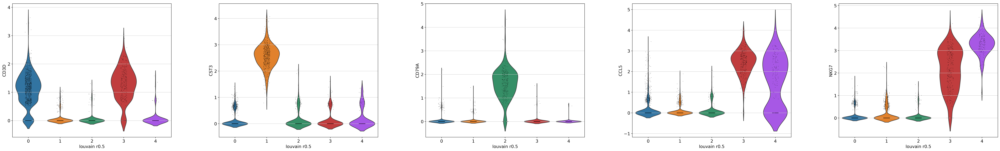

In [43]:
sc.pl.violin(adata, ['CD3D', 'CST3', 'CD79A', 'CCL5', 'NKG7'], groupby='louvain_r0.5')

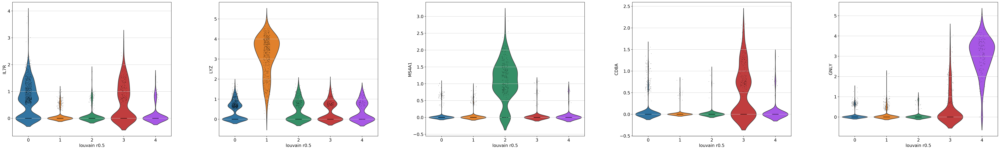

In [44]:
sc.pl.violin(adata, ['IL7R', 'LYZ', 'MS4A1', 'CD8A', 'GNLY'], groupby='louvain_r0.5')

If we were unsure about the makeup of one or more cluster we could check the fraction of known marker genes that are found in the cluster marker gene set.

I think cluster 0 is a Naive CD4+ T-Cell. To check the fraction of the known marker genes I can do:

In [45]:
marker_genes = dict()
marker_genes['Naive_T'] = ['CD45RA', 'CCR7', 'CD62L', 'CD27']

In [46]:
cell_annotation = sc.tl.marker_gene_overlap(adata, marker_genes, key='rank_genes_r0.5')
cell_annotation

,0,1,2,3,4
Naive_T,2.0,0.0,0.0,0.0,0.0


If you had a lot of different cell types you could make a heatmap of the gene overlap

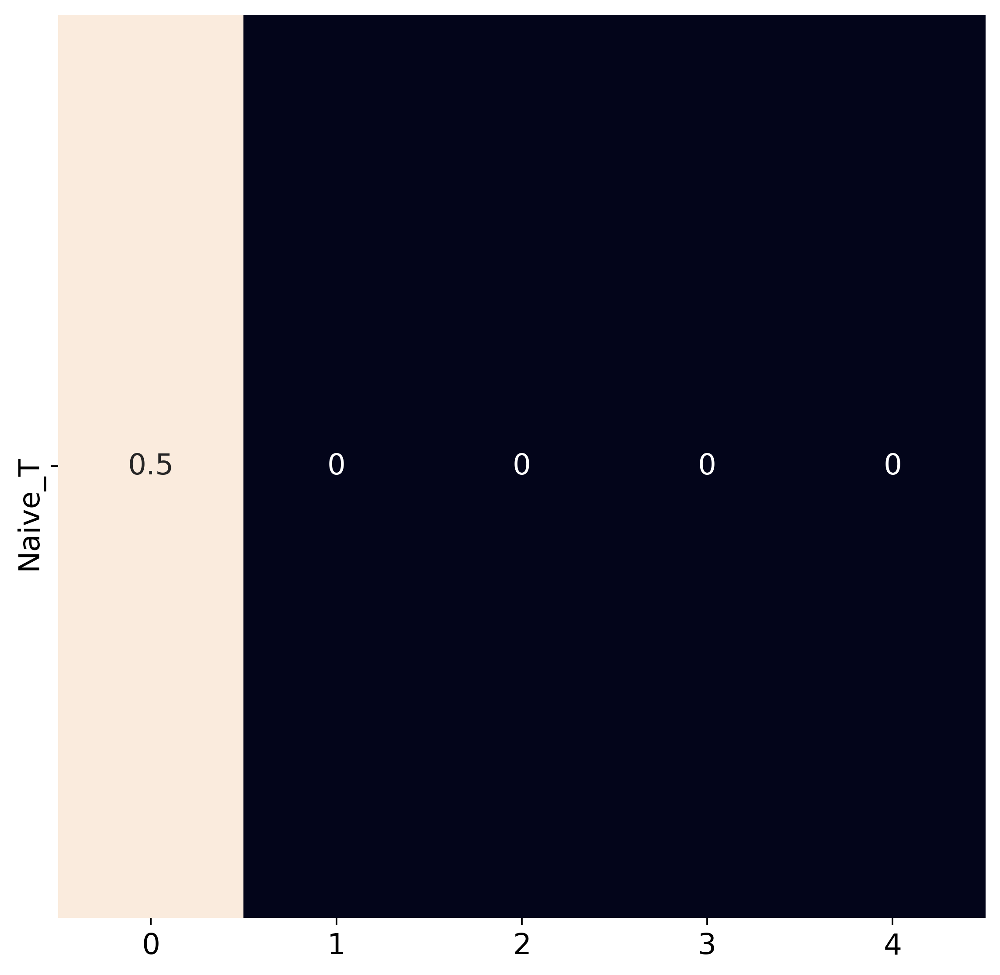

In [47]:
cell_annotation_norm = sc.tl.marker_gene_overlap(adata, marker_genes, key='rank_genes_r0.5', normalize='reference')
sb.heatmap(cell_annotation_norm, cbar=False, annot=True)

A more rigorous analysis would be to perform an enrichment test. Yet, in this data set the assignment is sufficiently clear so that it is not necessary.

Note that use_raw=False is used to visualize batch-corrected data on top of the UMAP layout.

In [48]:
new_cluster_names = ['CD4 T', 'Monocytes', 'B', 'CD8 T', 'NK']
adata.rename_categories('louvain_r0.5', new_cluster_names)

Omitting rank_genes_r0.5_clust3/scores as old categories do not match.
Omitting rank_genes_r0.5_clust3/names as old categories do not match.
Omitting rank_genes_r0.5_clust3/logfoldchanges as old categories do not match.
Omitting rank_genes_r0.5_clust3/pvals as old categories do not match.
Omitting rank_genes_r0.5_clust3/pvals_adj as old categories do not match.


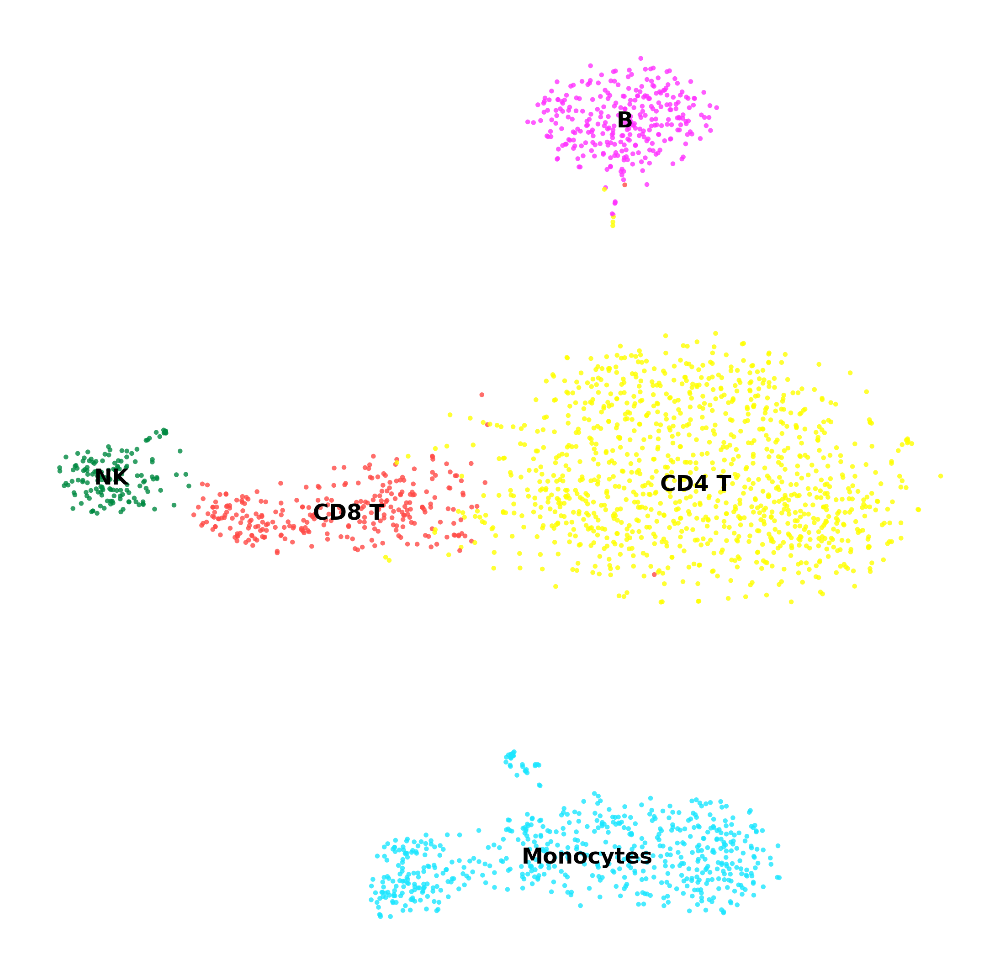

In [49]:
sc.pl.tsne(adata, color=['louvain_r0.5'], legend_loc='on data' ,title='', frameon=False, legend_fontsize=10, alpha=0.8, size=20, save = 'tsne_cellType_res0_5.pdf')

In [50]:
adata.obs['louvain_r0.5'].value_counts()

CD4 T        1077
Monocytes     601
B             295
CD8 T         287
NK            148
Name: louvain_r0.5, dtype: int64

We could also look at some of our marker genes on the umap or t-sne plots

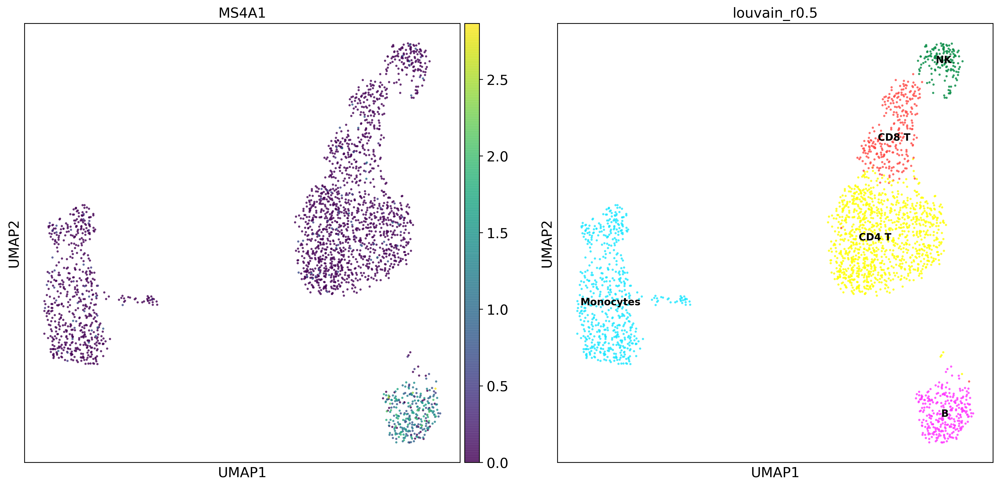

In [51]:
sc.pl.umap(adata, color=['MS4A1', 'louvain_r0.5'], legend_loc='on data', legend_fontsize=10, alpha=0.8, size=20)

## 3.3 Subclustering 

To build on the basis clustering, we can now subcluster parts of the data to identify substructure within the identified cell types. Here, we subcluster the 'Monocyte' population to see if we can find any difference in the monocytes in this cluster.

Subclustering is normally performed at a lower resolution than on the entire dataset given that clustering is more sensitive when performed on a small subset of the data.

In [52]:
#Subcluster enterocytes
sc.tl.louvain(adata, restrict_to=('louvain_r0.5', ['Monocytes']), resolution=0.2, key_added='louvain_r0.5_Mono_sub')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 7 clusters and added
    'louvain_r0.5_Mono_sub', the cluster labels (adata.obs, categorical) (0:00:00)


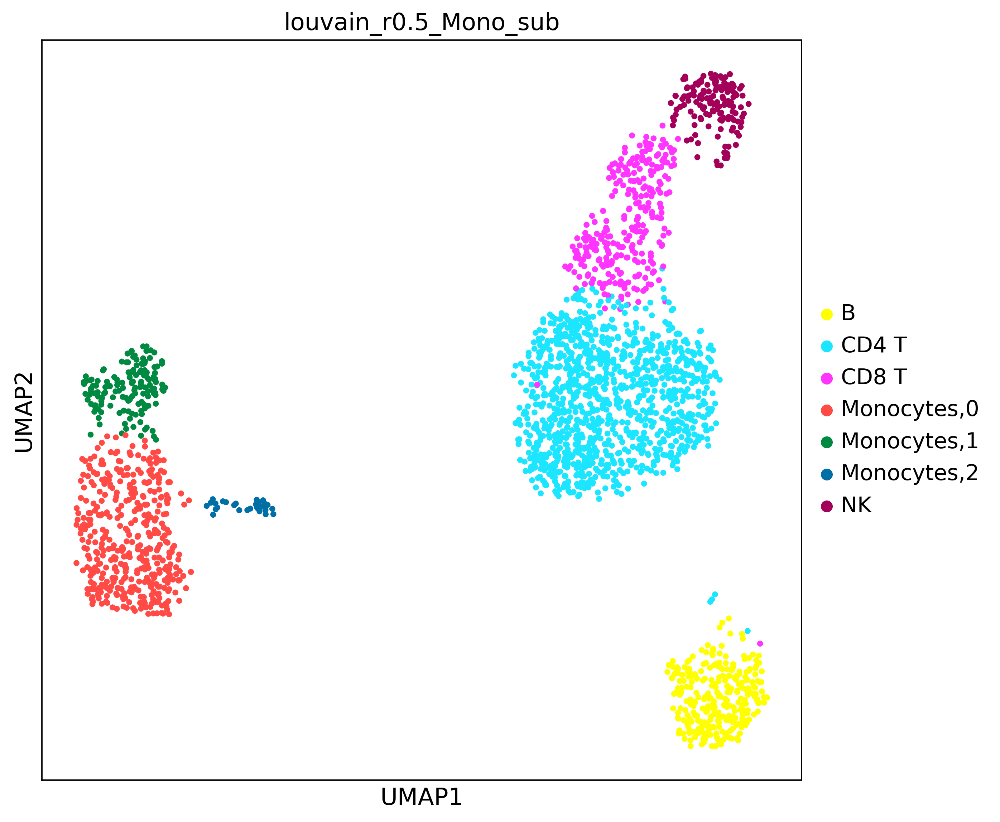

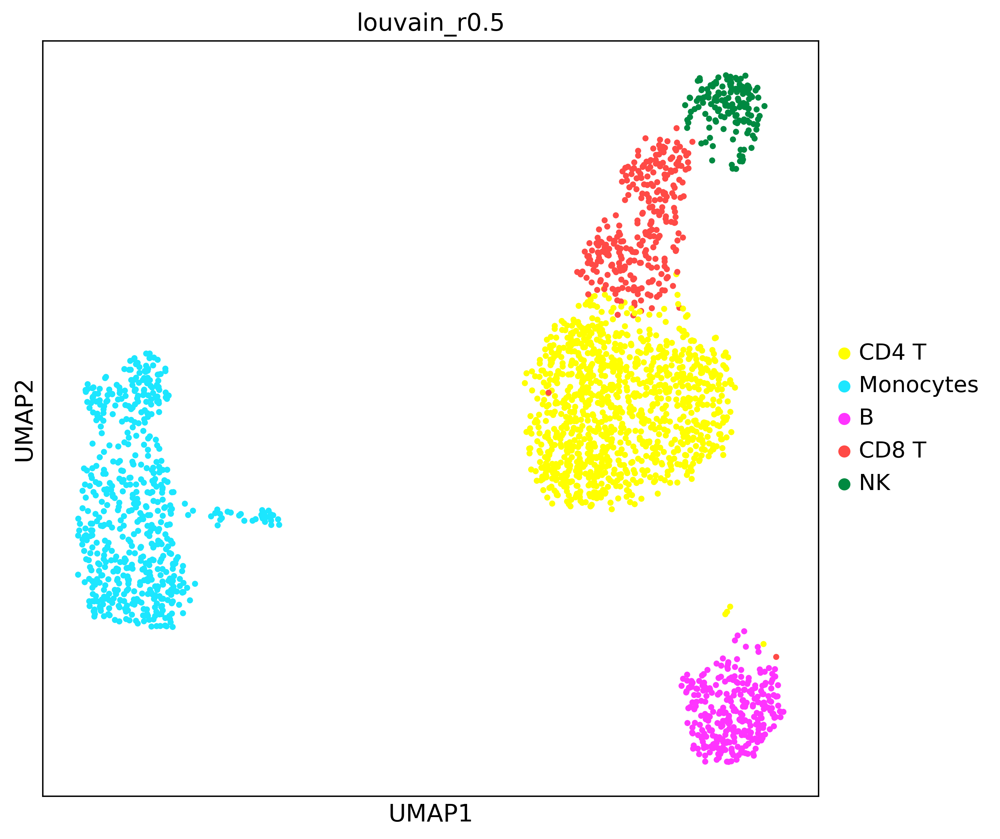

In [53]:
#Show the new clustering
if 'louvain_r0.5_Mono_sub_colors' in adata.uns:
    del adata.uns['louvain_r0.5_Mono_sub_colors']

sc.pl.umap(adata, color='louvain_r0.5_Mono_sub', palette=sc.pl.palettes.godsnot_64)
sc.pl.umap(adata, color='louvain_r0.5', palette=sc.pl.palettes.godsnot_64)

The monocyte cluster broke up into three clusters and now we can find the marker genes in these clusters

In [54]:
#Get the new marker genes
sc.tl.rank_genes_groups(adata, groupby='louvain_r0.5_Mono_sub', key_added='rank_genes_r0.5_Mono_sub')

ranking genes
    finished: added to `.uns['rank_genes_r0.5_Mono_sub']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


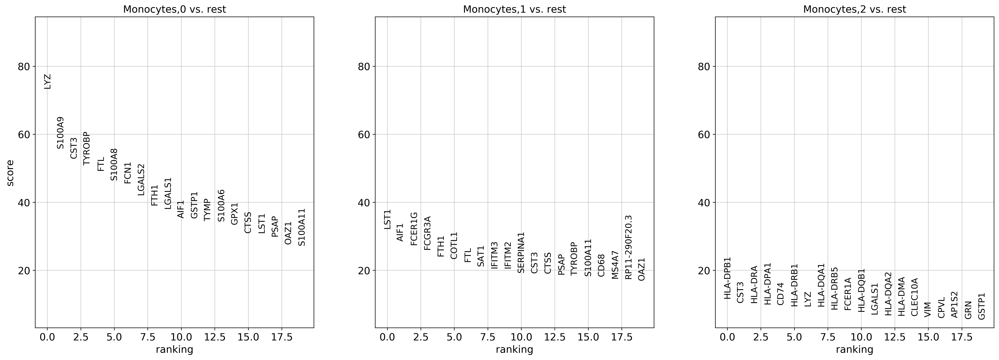

In [55]:
#Plot the new marker genes
sc.pl.rank_genes_groups(adata, key='rank_genes_r0.5_Mono_sub', groups=['Monocytes,0','Monocytes,1','Monocytes,2'], fontsize=12)

In [56]:
pd.DataFrame(adata.uns['rank_genes_r0.5_Mono_sub']['names']).head(10)

,B,CD4 T,CD8 T,"Monocytes,0","Monocytes,1","Monocytes,2",NK
0,CD79A,LDHB,CCL5,LYZ,LST1,HLA-DPB1,NKG7
1,CD74,RPS12,NKG7,S100A9,AIF1,CST3,GNLY
2,HLA-DRA,RPS27,CST7,CST3,FCER1G,HLA-DRA,GZMB
3,CD79B,RPS25,GZMA,TYROBP,FCGR3A,HLA-DPA1,PRF1
4,HLA-DQA1,CD3D,IL32,FTL,FTH1,CD74,CTSW
5,MS4A1,RPS6,B2M,S100A8,COTL1,HLA-DRB1,GZMA
6,HLA-DPB1,RPS3,CTSW,FCN1,FTL,LYZ,CST7
7,HLA-DRB1,RPL3,GZMK,LGALS2,SAT1,HLA-DQA1,FGFBP2
8,HLA-DQB1,RPL31,HLA-C,FTH1,IFITM3,HLA-DRB5,HLA-C
9,HLA-DPA1,RPL30,CD8A,LGALS1,IFITM2,FCER1A,B2M


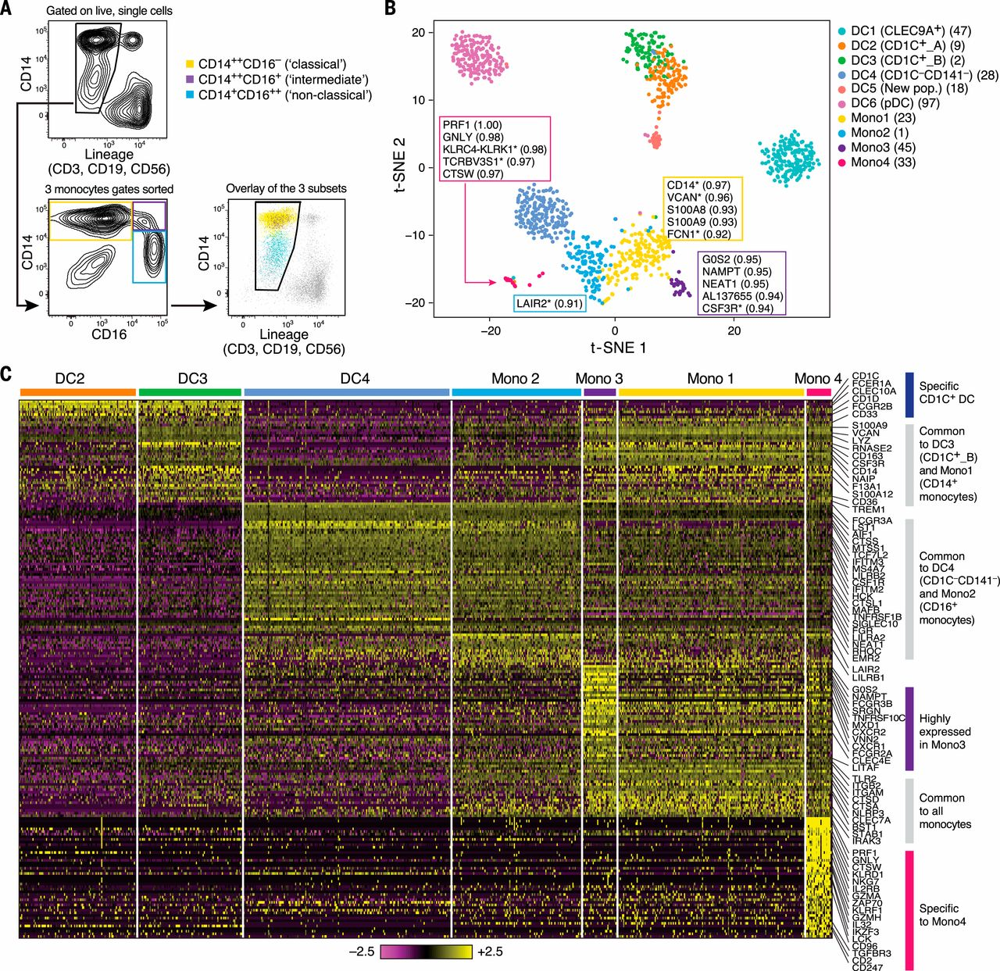

In [57]:
Image("Fig4_Mono_het.jpg")

"Single-cell RNA-seq reveals new types of human blood dendritic cells, monocytes, and progenitors" Science, April 21, 2017 = seems to indicate the our "Monocytes 2" cluster are dendritic cells = "Numerous studies have shown that human dendritic cells express high levels of major histocompatibility complex (MHC) class II (HLA-DR), a molecule essential for antigen presentation..."

Judging from their Fig4, our Monocytes 0 is their Mono1 and our Monocyte 1 is their Mono 2

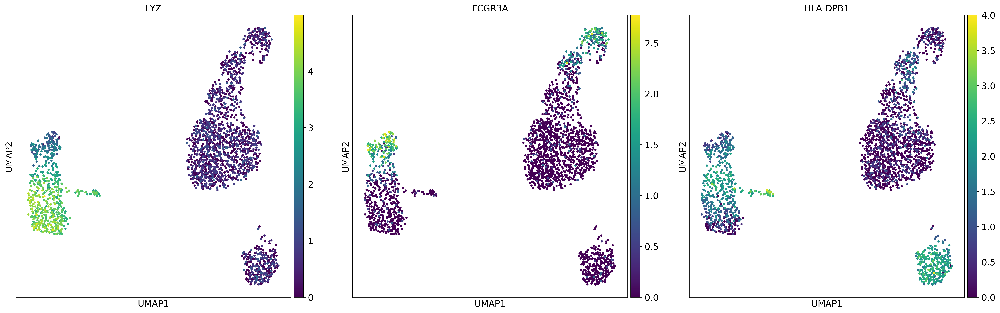

In [58]:
#Visualize some Monocyte markers
Mono_genes = ['LYZ', 'FCGR3A', 'HLA-DPB1']
sc.pl.umap(adata, color=Mono_genes[:3], title=Mono_genes[:3])

In [59]:
#Categories to rename
adata.obs['louvain_r0.5_Mono_sub'].cat.categories

Index(['B', 'CD4 T', 'CD8 T', 'Monocytes,0', 'Monocytes,1', 'Monocytes,2',
       'NK'],
      dtype='object')

In [60]:
adata.rename_categories('louvain_r0.5_Mono_sub', ['B', 'CD4 T', 'CD8 T', 'Mono1', 'Mono2', 'Dendritic', 'NK'])

To make things simpler we can now rename to our final clustering "louvain_final"

In [61]:
adata.obs['louvain_final'] = adata.obs['louvain_r0.5_Mono_sub']

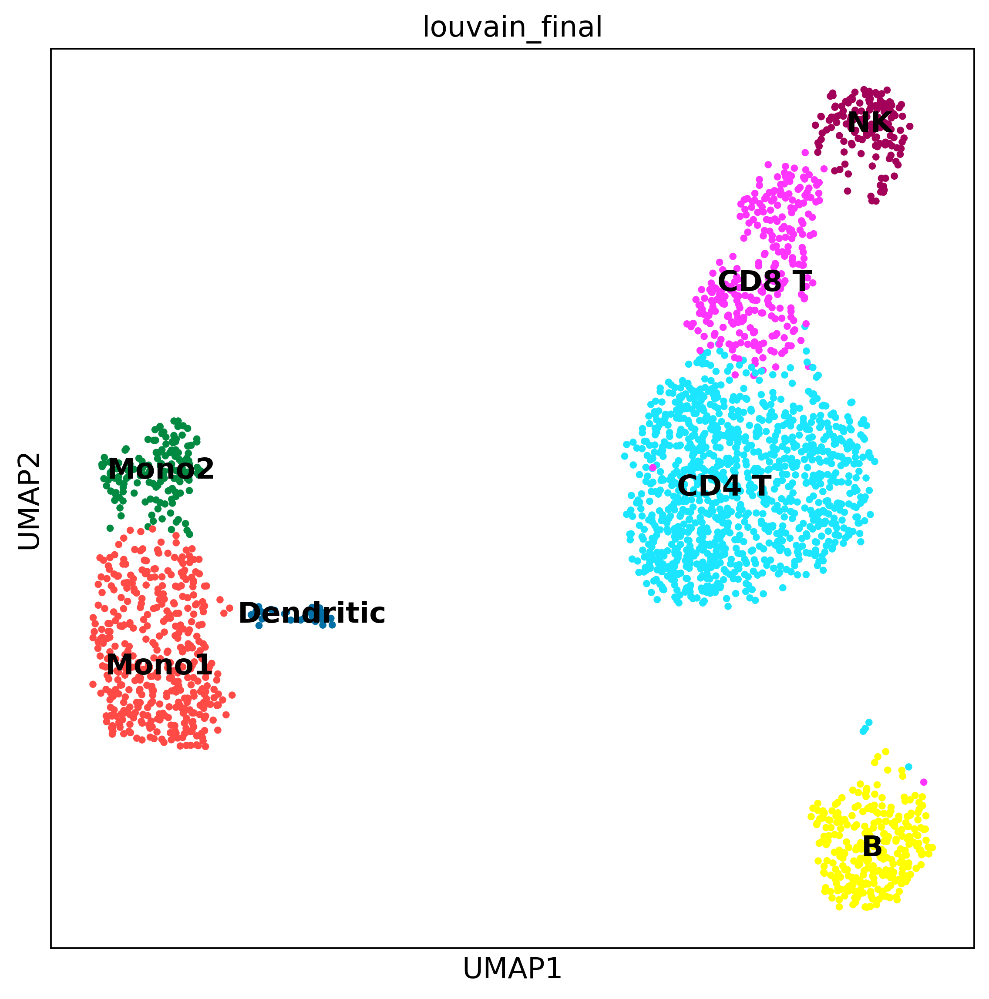

In [62]:
sc.pl.umap(adata, color='louvain_final', palette=sc.pl.palettes.default_64, legend_loc='on data')

In [63]:
adata.obs['louvain_final'].value_counts()

CD4 T        1077
Mono1         421
B             295
CD8 T         287
Mono2         149
NK            148
Dendritic      31
Name: louvain_final, dtype: int64

## 3.4 Trajectory Inference and pseudotime analysis 

As our data set contains differentiation processes, we can investigate the differentiation trajectories in the data. This analysis is centred around the concept of 'pseudotime'. In pseudotime analysis a latent variable is inferred based on which the cells are ordered. This latent variable is supposed to measure the differentiation state along a trajectory.

Pseudotime analysis is complicated when there are multiple trajectories in the data. In this case, the trajectory structure in the data must first be found before pseudotime can be inferred along each trajectory. The analysis is then called 'trajectory inference'.

Once the pseudotime variable is inferred, we can test for genes that vary continuously along pseudotime. These genes are seen as being associated with the trajectory, and may play a regulatory role in the potential differentiation trajectory that the analysis found.

Here, we measure the trajectory of the B/T/NK cells, which are supposed to be derived from a common progenitor. We also investigate which genes vary along pseudotime.

Based on a recent comparison of pseudotime methods [Saelens et al., 2018], we have selected two of the top performing 'Monocle2', and 'Diffusion Pseudotime (DPT)'. Two methods were chosen as trajectory inference is a complex problem which is not yet solved. Different methods perform well on different types of trajectories. For example, 'Slingshot' was the top performer for simple bifurcating and multifurcating trajectories but takes more time and therefore we will skip this time; 'Monocle2' performed best for complex tree structures, and 'DPT' performed well in bifurcating trajectories. As the complexity of trajectories are generally not known, it is adviseable to compare trajectory inference outputs.

We first subset the data to include only the B cell, T cell, and NK cell clusters. After subsetting it is important to recalculate the dimensionality reduction methods such as PCA, and diffusion maps, as the variability of the subsetted data set will be projected onto different basis vectors.

Note that we subset the data to include only the cells we want to examine. Trajectory inference, and especially measuring gene expression changes over pseudotime can be a computationally expensive process, thus we often work with reduced gene sets that are informative of the variance in the data.

In [64]:
#Subsetting to relevant clusters
clusters_to_include = [g for g in adata.obs['louvain_final'].cat.categories if (g.startswith('CD4 T') or g.startswith('CD8 T') or g.startswith('NK') or g.startswith('B'))]
adata_BTNK = adata[np.isin(adata.obs['louvain_final'], clusters_to_include),:].copy()

#Subset to highly variable genes
sc.pp.highly_variable_genes(adata_BTNK, flavor='cell_ranger', n_top_genes=2500, subset=True)

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


As we have subsetted the data to include only cell types that we assume are of interest, we recalculate the dimension reduction algorithms on this data. This ensures that for example the first few PCs capture only the variance in this data and not variance in parts of the full data set we have filtered out.

computing PCA with n_comps = 50
computing PCA on highly variable genes
    finished (0:00:00)


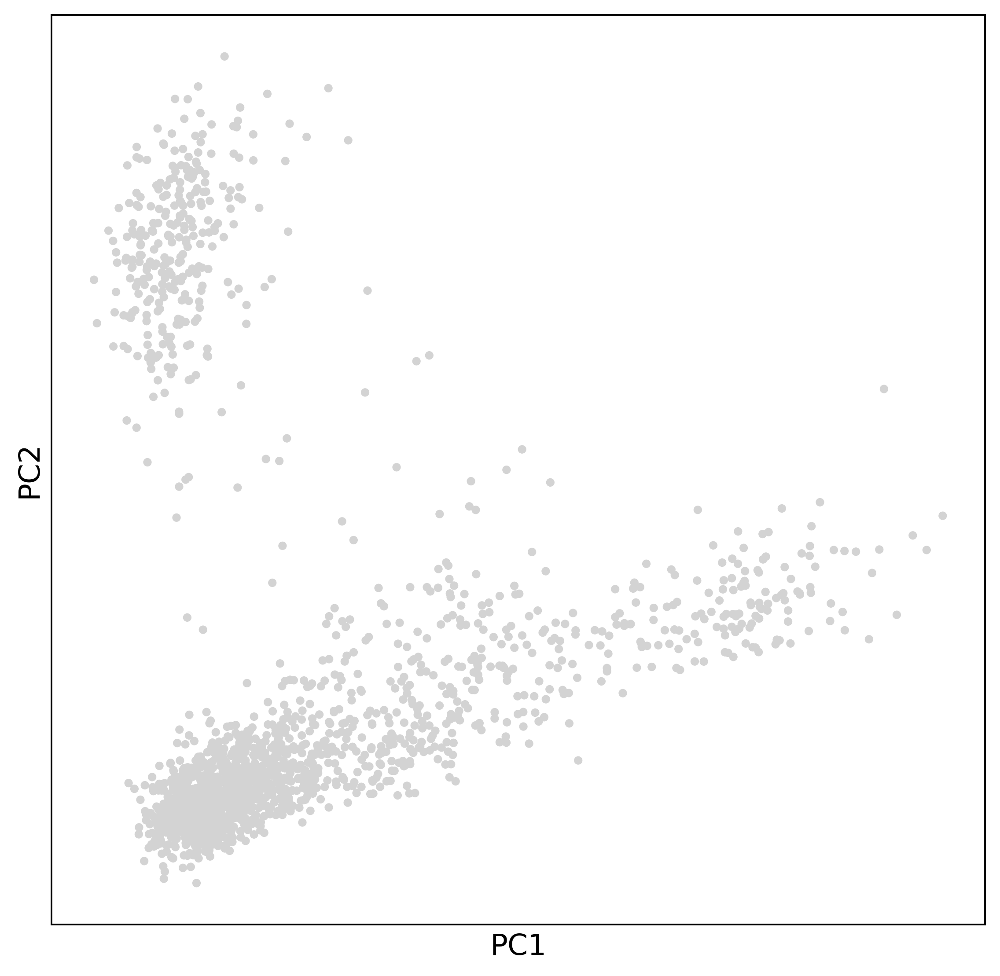

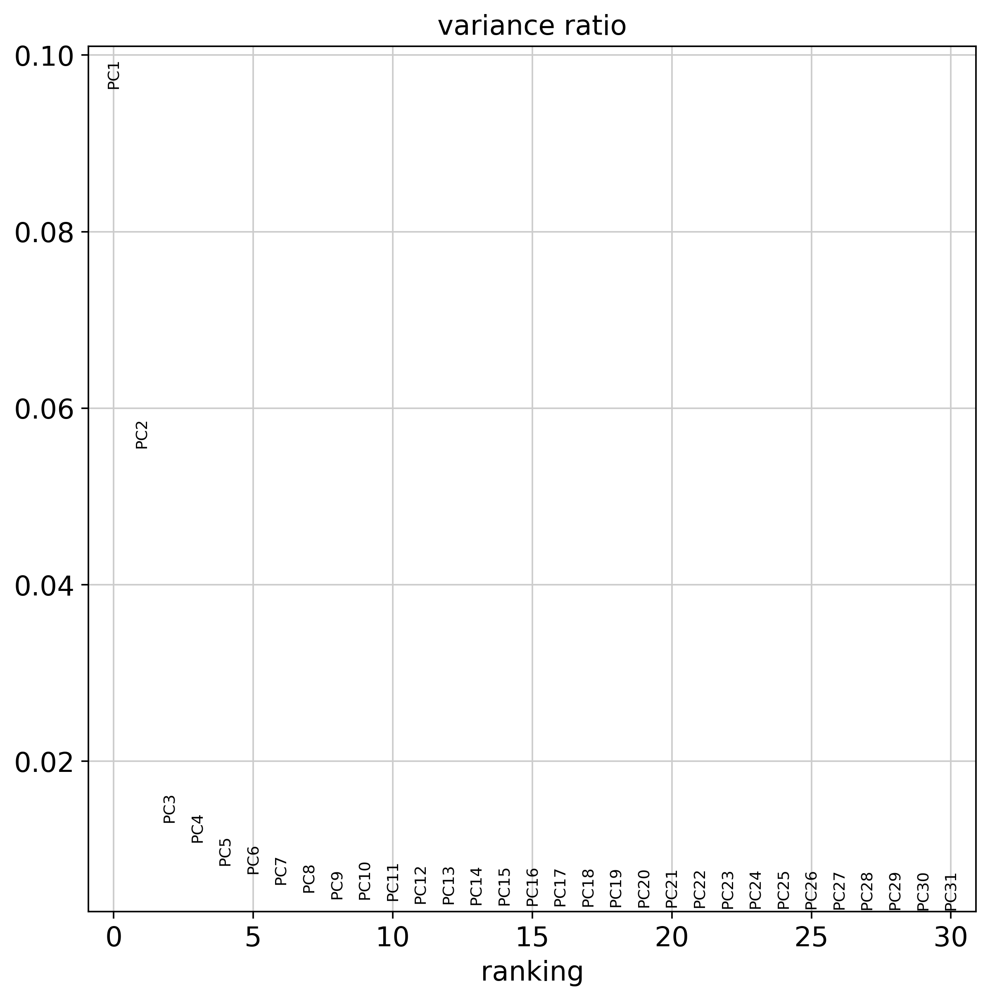

In [65]:
#Recalculating PCA for subset
sc.pp.pca(adata_BTNK, svd_solver='arpack')
sc.pl.pca(adata_BTNK)
sc.pl.pca_variance_ratio(adata_BTNK)

Trajectory inference is often performed on PCA-reduced data, as is the case for Slingshot and Monocle2. To assess how many principal components (PCs) should be included in the low-dimensional representation we can use the 'elbow method'. This method involves looking for the 'elbow' in the plot of the variance ratio explained per PC. Above we can see the elbow at PC6. Thus the first six PCs are included in the slingshot data.

In [66]:
adata_BTNK.obsm['X_pca'] = adata_BTNK.obsm['X_pca'][:,0:6]

## 3.4.1 Monocle2

Monocle2 is written in R. The integration of R in this notebook is again achieved via the rpy2 interface. We use a specifically developed package called anndata2ri (https://www.github.com/flying-sheep/anndata2ri), that takes care of the conversion from an AnnData object to R. It should be noted that the convention for scRNA-seq data matrix storage in R is opposite to python. In R the expression matrix is stored as genes x cells rather than cells x genes. Thus, the matrix must be transposed before being input into the R function. This is already taken care of by anndata2ri.

The monocle toolbox is one of the most popular trajectory inference toolboxes in the field. It has been shown to perform particularly well on complex trajectories. Although we only have a simple bi- or multifurcating trajectory here we use Monocle2 to confirm the suspected trajectory.

Monocle2 is not as much a standalone trajectory inference method, than a trajectory inference toolbox. This toolbox includes preprocessing steps and a dimensionality reduction function. It is designed in such a way that integrating preprocessed data into the data structure is non-trivial. This is likely by intent to not interfere with the optimized pipeline. Thus, we use Monocle2 on our data set from the raw data. Our cluster labels are later overlayed onto the Monocle2 output to compare the trajectory with expectations.

Implementation note:
- this section closely follows the monocle 2 tutorial

In [67]:
#Preprocessing for monocle
data_mat_mon = adata.layers['counts'].T
var_mon=adata.var.copy()
obs_mon=adata.obs.copy()

In [68]:
%%R -i data_mat_mon -i obs_mon -i var_mon

#Set up the CellDataSet data structure
pd <- AnnotatedDataFrame(data = obs_mon)
fd <- AnnotatedDataFrame(data = var_mon)
colnames(data_mat_mon) <- rownames(pd)
rownames(data_mat_mon) <- rownames(fd)
ie_regions_cds <- newCellDataSet(cellData=data_mat_mon, phenoData=pd, featureData=fd, expressionFamily=negbinomial.size())

#Normalize the count data
ie_regions_cds <- estimateSizeFactors(ie_regions_cds)

#Calculate dispersions to filter for highly variable genes
ie_regions_cds <- estimateDispersions(ie_regions_cds)

R[write to console]: Removing 213 outliers



In [69]:
%%R

#Filter for B, CD4 T, CD8 T, and NK cells
cell_types = as.character(pData(ie_regions_cds)$louvain_final)
cell_mask = rep(FALSE, length(cell_types))
cells_to_keep = c("B", "CD4 T", "CD8 T", "NK")
for (item in cells_to_keep) {cell_mask = cell_mask | startsWith(cell_types, item)}
print("Number of cells after filtering:")
print(sum(cell_mask))
print("")

#Filter highly variable genes from our analysis
hvg_mask = fData(ie_regions_cds)$highly_variable
ie_regions_cds <- ie_regions_cds[hvg_mask, cell_mask]

#Do dimensionality reduction
ie_regions_cds <- reduceDimension(ie_regions_cds, norm_method = 'vstExprs', reduction_method='DDRTree', verbose = F, max_components = 7)

#Run for the first time to get the ordering
ie_regions_cds <- orderCells(ie_regions_cds)

#Find the correct root state that corresponds to the 'CD4 T' cluster potentially
tab1 <- table(pData(ie_regions_cds)$State, pData(ie_regions_cds)$louvain_final)
id = which(colnames(tab1) == 'CD4 T')
root_name = names(which.max(tab1[,id]))

#Run a second time to get the correct root state that overlaps with CD4 T cells
ie_regions_cds <- orderCells(ie_regions_cds, root_state=root_name)

[1] "Number of cells after filtering:"
[1] 1807
[1] ""


R[write to console]: Registered S3 methods overwritten by 'proxy':
  method               from    
  print.registry_field registry
  print.registry_entry registry



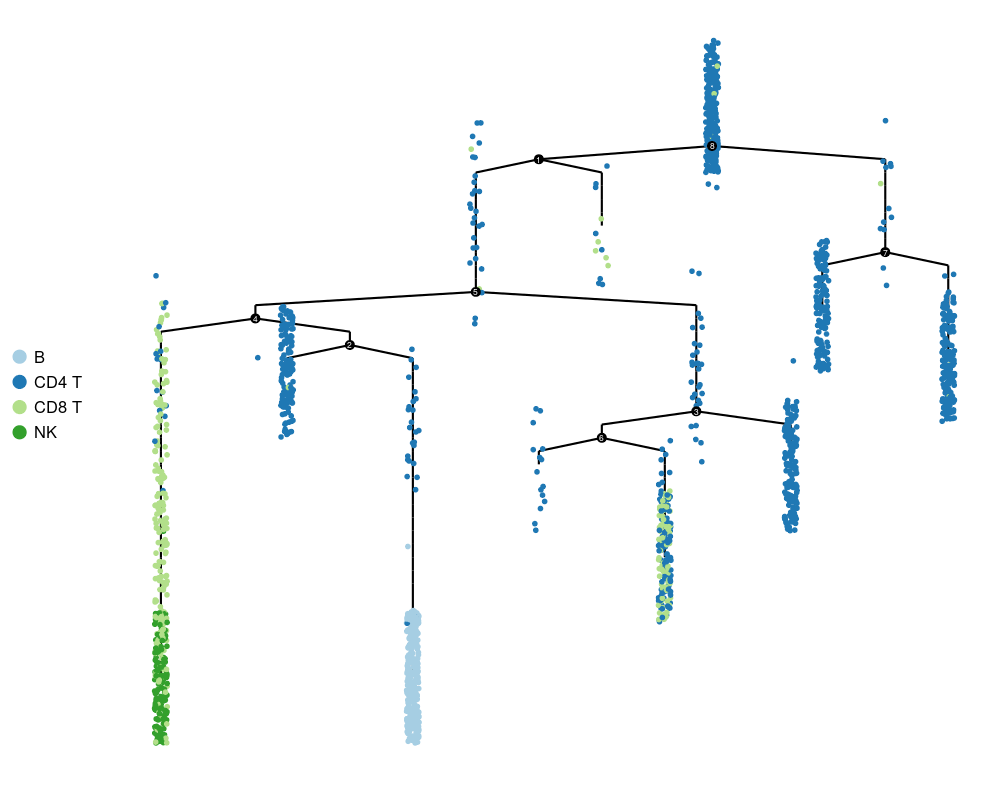

In [70]:
%%R -w 1000 -h 800

#Get a nice colour map
custom_colour_map = brewer.pal(length(unique(pData(ie_regions_cds)$louvain_final)),'Paired')

#Find the correct root state that coresponds to the 'CD4 T' cluster
tab1 <- table(pData(ie_regions_cds)$State, pData(ie_regions_cds)$louvain_final)
id = which(colnames(tab1) == 'CD4 T')
root_name = names(which.max(tab1[,id]))

# Visualize with our cluster labels
options(repr.plot.width=5, repr.plot.height=4)
plot_complex_cell_trajectory(ie_regions_cds, color_by = 'louvain_final', show_branch_points = T, 
                             cell_size = 2, cell_link_size = 1, root_states = c(root_name)) +
scale_size(range = c(0.2, 0.2)) +
theme(legend.position="left", legend.title=element_blank(), legend.text=element_text(size=rel(1.5))) +
guides(colour = guide_legend(override.aes = list(size=6))) + 
scale_color_manual(values = custom_colour_map)

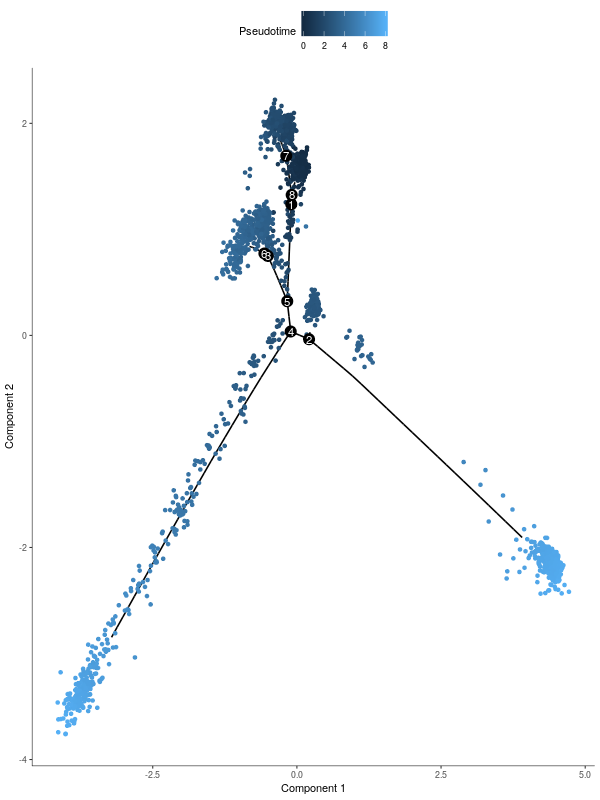

In [71]:
%%R -w 600 -h 800

#Visualize pseudotime found
options(repr.plot.width=5, repr.plot.height=4)
plot_cell_trajectory(ie_regions_cds, color_by="Pseudotime")

Monocle2 is able to find complex branching. The trajectories off branching point 4 take up a lot of the pseudotime covariate. These trajectories loosely separate out the B cell trajectory, although it also seems to separate the NK trajectory.

The 'CD4 T' and 'CD8 T' clusters have been separated into several branches. This separation may indicate that a heterogeneity in these clusters beyond the labels we have assigned, which is not suprising. As we have filtered out several cell-types some of these branches may represent differentiation trajectories towards other mature cell fates. An alternative explanation for the detected lineage heterogeneity is that monocle has picked up on cell-cycle effects, which it cannot reconcile with the acyclic tree structure it is fitting.

Given that we have passed Monocle2 a comparatively simple trajectory inference problem, the observed performance is not unexpected. Monocle2 has been found to perform better on more complex topologies.

## 3.4.2 Diffusion Pseudotime (DPT) 

We include Diffusion Pseudotime in the analysis to further support the found trajectories. Diffusion pseudotime is integrated into scanpy and is therefore easy to use with the current setup.

DPT is based on diffusion maps, thus a diffusion map representation must be calculated prior to pseudotime inference. This in turn is based on a KNN graph embedding obtained from sc.pp.neighbors().

In [72]:
sc.pp.neighbors(adata_BTNK)
sc.tl.diffmap(adata_BTNK)

computing neighbors
    using 'X_pca' with n_pcs = 6
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:00:00)
computing Diffusion Maps using n_comps=15(=n_dcs)
computing transitions
    finished (0:00:00)
    eigenvalues of transition matrix
    [1.         0.9967907  0.99391824 0.9799006  0.9680883  0.9464636
     0.94303316 0.93705076 0.9347709  0.92827505 0.9212122  0.9085431
     0.8981081  0.8926586  0.8852392 ]
    finished: added
    'X_diffmap', diffmap coordinates (adata.obsm)
    'diffmap_evals', eigenvalues of transition matrix (adata.uns) (0:00:00)


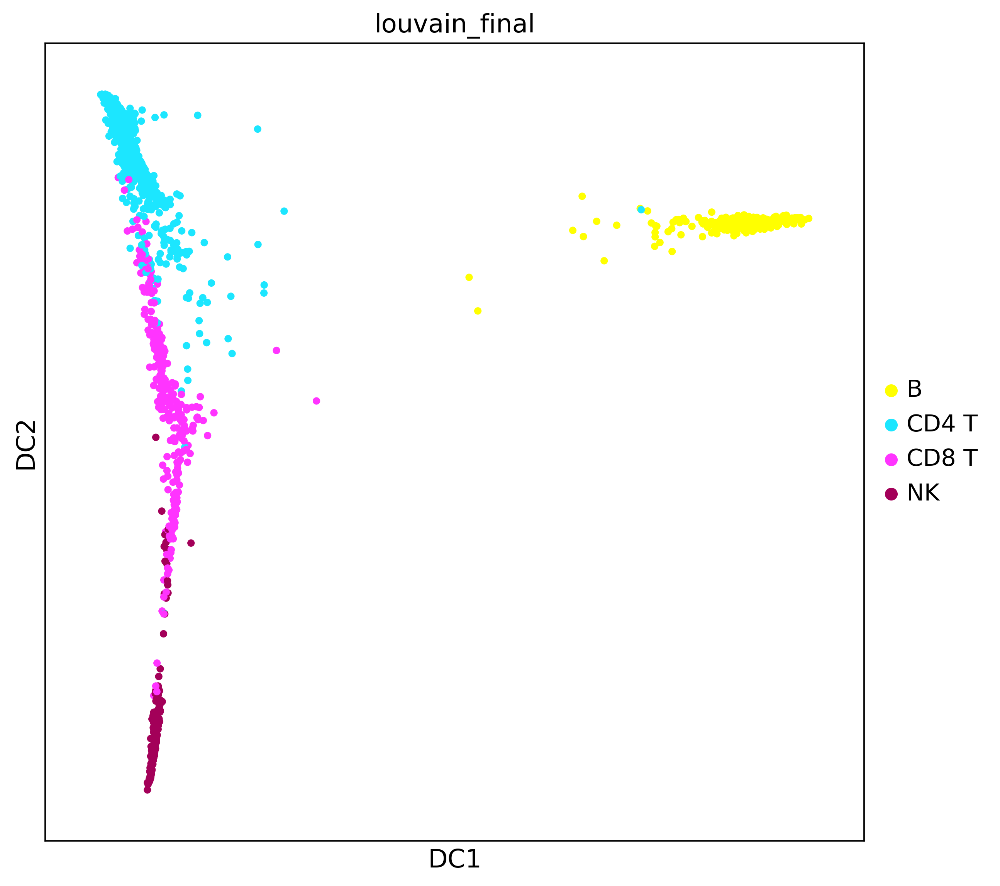

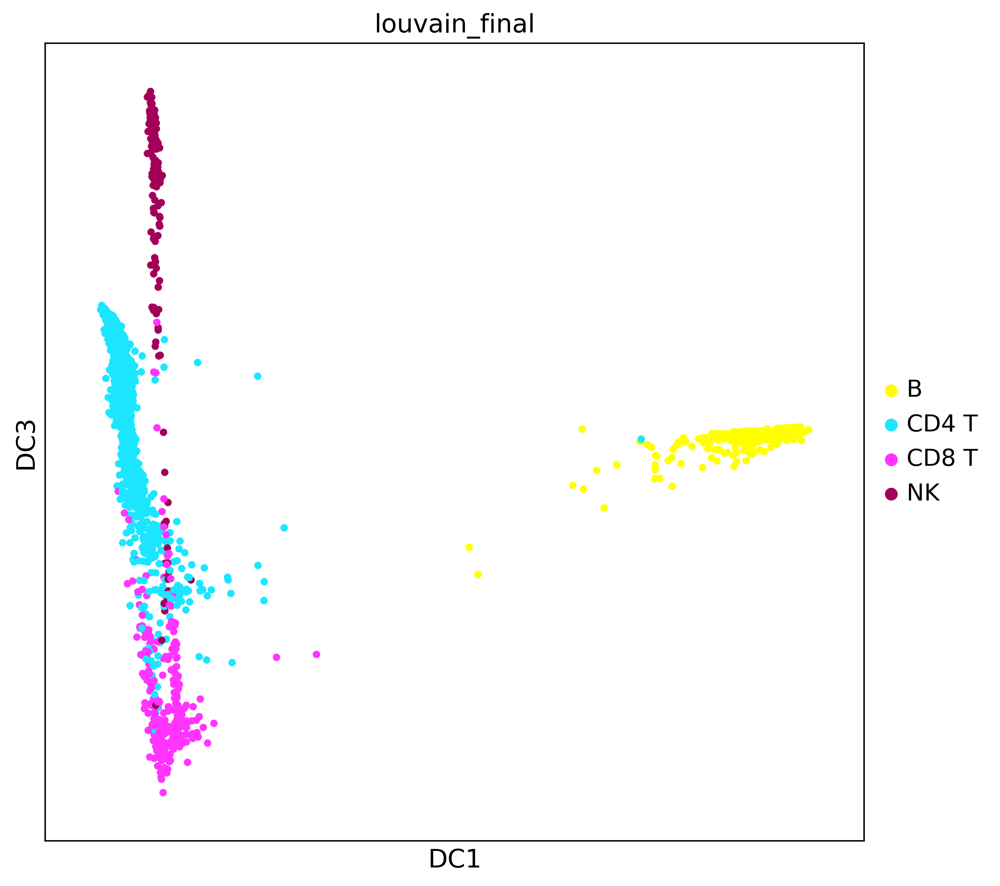

In [73]:
sc.pl.diffmap(adata_BTNK, components='1,2', color='louvain_final')
sc.pl.diffmap(adata_BTNK, components='1,3', color='louvain_final')

Looking at the first three diffusion components (DCs) we can see that DC3 separates the NK trajectory.

In DPT we must assign a root cell to infer pseudotime. In the plots we can observe that the most appropriate root will be either the CD4 T or CD8 T cell. We will stick with the CD4 T cell for consistency and because it has the minimum DC1 and the maximum DC2 value.

Note that 'DC3' is stored in adata_BTNK.obsm['X_diffmap'][:,3] as the 0-th column is the steady-state solution, which is non-informative in diffusion maps.

In [74]:
#Find the CD4 T cell with the highest DC3 value to act as root for the diffusion pseudotime and compute DPT
stem_mask = np.isin(adata_BTNK.obs['louvain_final'], 'CD4 T')
max_stem_id = np.argmin(adata_BTNK.obsm['X_diffmap'][stem_mask,3])
root_id = np.arange(len(stem_mask))[stem_mask][max_stem_id]
adata_BTNK.uns['iroot'] = root_id

#Compute dpt
sc.tl.dpt(adata_BTNK)

computing Diffusion Pseudotime using n_dcs=10
    finished: added
    'dpt_pseudotime', the pseudotime (adata.obs) (0:00:00)


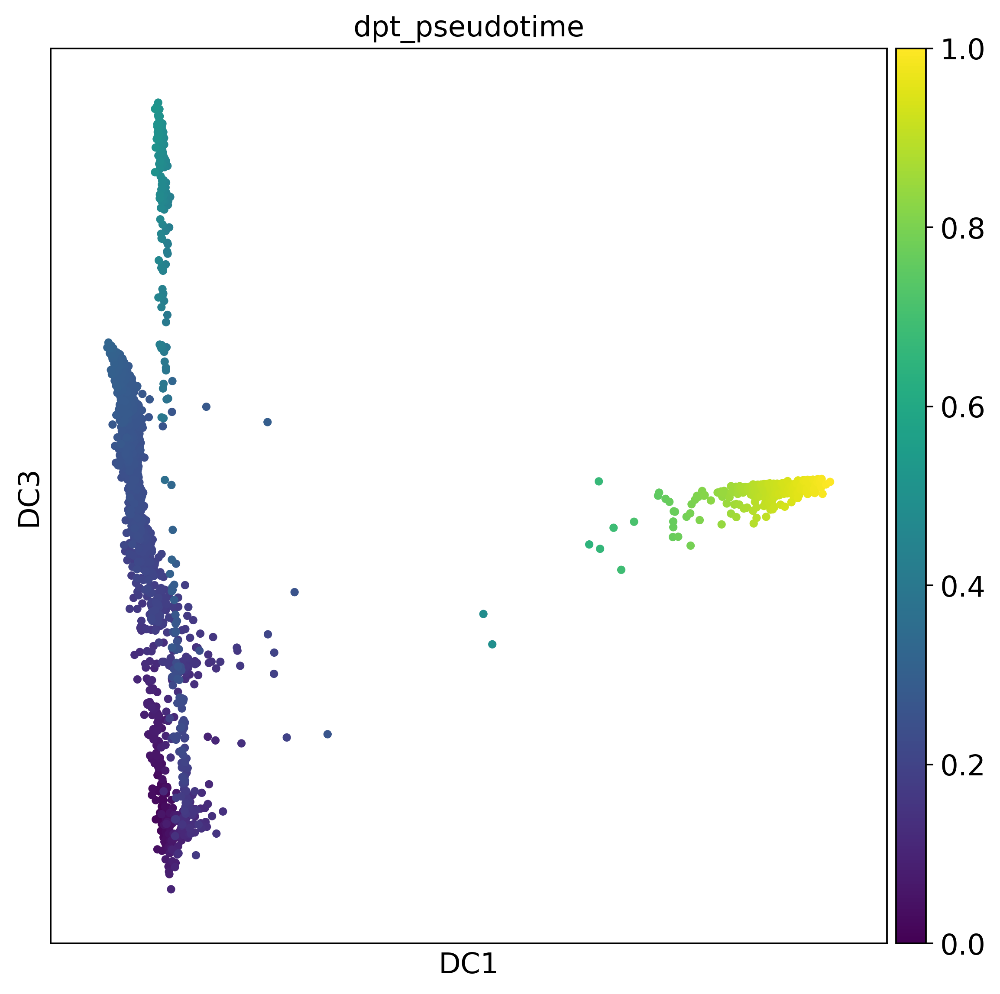

In [75]:
#Visualize pseudotime over differentiation
sc.pl.diffmap(adata_BTNK, components='1,3', color='dpt_pseudotime')

# 3.5 Partition-based graph abstraction

Partition-based graph abstraction (PAGA) is a method to reconcile clustering and pseudotemporal ordering. It can be applied to an entire dataset and does not assume that there are continuous trajectories connecting all clusters.

As PAGA is integrated into scanpy, we can easily run it on the entire data set. Here we run and visualize PAGA with different clustering inputs.

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])


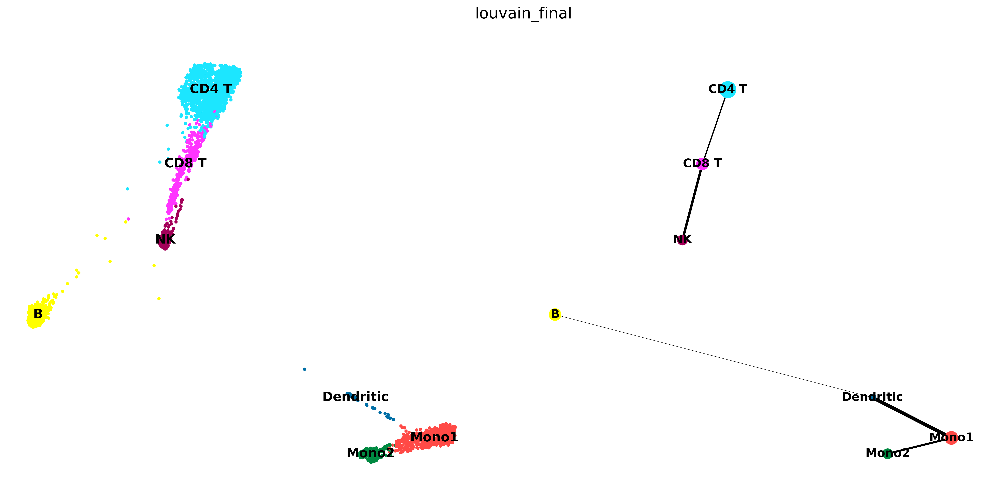

--> added 'pos', the PAGA positions (adata.uns['paga'])


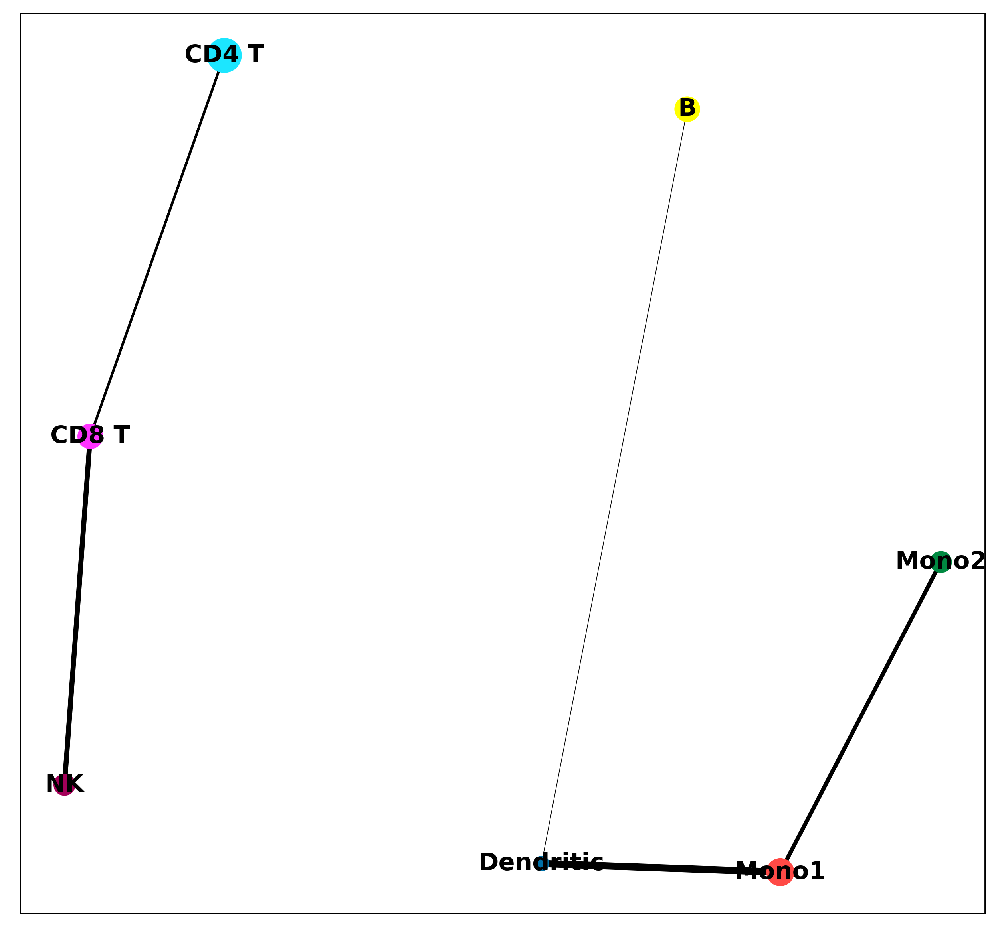

In [76]:
sc.tl.paga(adata, groups='louvain_final')
sc.pl.paga_compare(adata)
sc.pl.paga(adata)

The close connectivity of the two different subclusters shows the similarity of these cells. However, we would have predicted the B cells would be closer to the CD cluster. This result shows that not all connections in PAGA represent differentiation trajectories, but instead transcriptional similarity between states. Thus, further experiments are required to confirm potential lineage trajectories obtained via PAGA or other trajectory inference methods.

We can do the same visualization on a umap layout.

--> added 'pos', the PAGA positions (adata.uns['paga'])


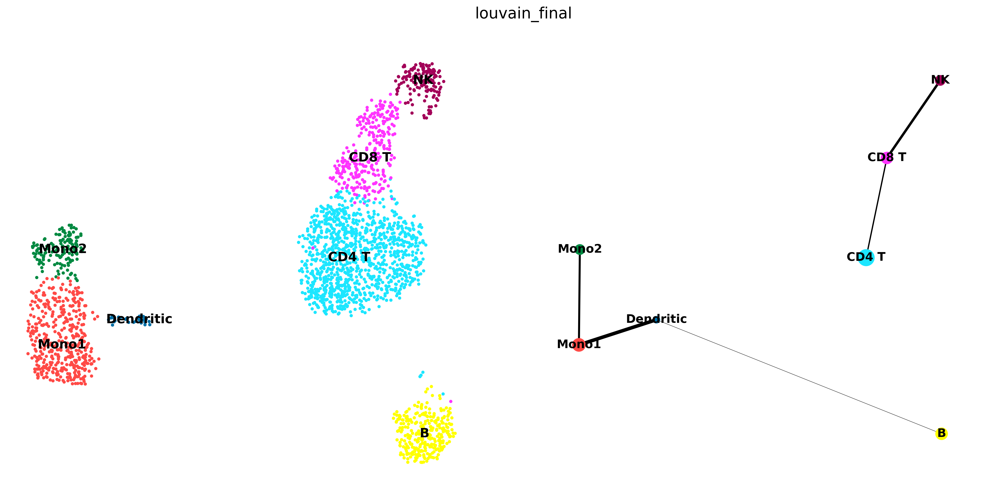

In [77]:
sc.pl.paga_compare(adata, basis='umap')

--> added 'pos', the PAGA positions (adata.uns['paga'])


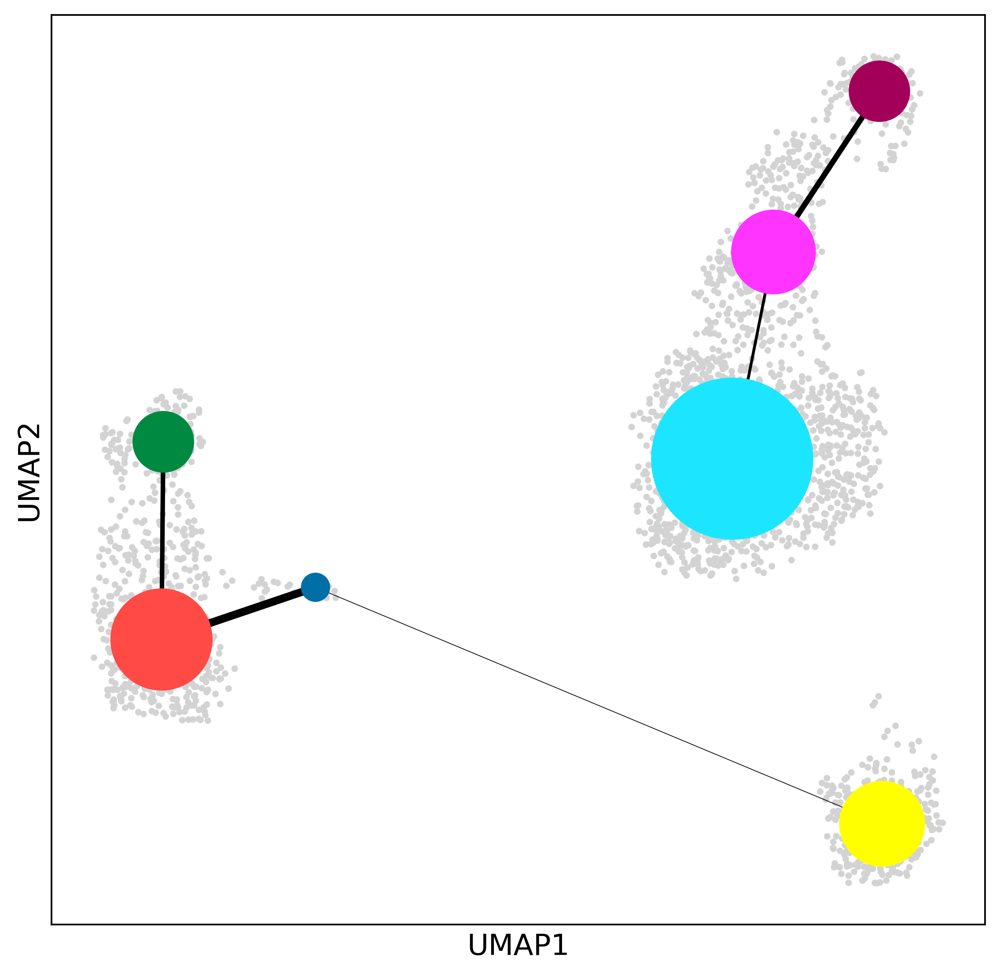

In [78]:
fig1, ax1 = plt.subplots()
sc.pl.umap(adata, size=40, ax=ax1, show=False)
sc.pl.paga(adata, pos=adata.uns['paga']['pos'], show=False, node_size_scale=10, node_size_power=1, ax=ax1, text_kwds={'alpha':0})
#plt.savefig('./figures/umap_paga_overlay_PBMCs.pdf', dpi=300, format='pdf')
plt.show()

Implementation note:

Note that the above plotting function only works when sc.pl.paga_compare(adata, basis='umap') is run before. The sc.pl.paga_compare() function stores the correct positions in adata.uns['paga']['pos'] to overlay the PAGA plot with a umap representation. To overlap PAGA with other representation, you can run sc.pl.paga_compare() with other basis parameters before plotting the combined plot.

Regressing out the cell cycle effect will likely change how 'TA' cells are included in the trajectory. In this manner trajectory inference and graph abstraction can be iteratively improved. Trajectory inference and PAGA can be iteratively improved to better represent the biology. Knowing when to stop attempting to improve, or assessing when all of the relevant technical covariates have been taken into account can only be achieved with sufficient knowledge of the biological system, experience, and possibly some luck.

It should also be noted that while an abstracted graph or an inferred trajectory can help to infer a lineage tree, experimental validation is necessary. Key driving forces in lineage specification might be lowly expressed genes and therefore neglected in the graph or even excluded in the HVG filtering.

# 3.6 Gene-level analysis

## 3.6.1 Differential testing 

In this section we will test which genes are differentially expressed between cell types found in the PBMCs. For simplicity, we will test differences between the B cells because they are one of the more distinct cell types. This test doesn't really make sense because we don't have separate conditions within the B cells but is here as a reference.

We perform differential testing using the MAST package. MAST compared favourably to other methods for scRNA-seq differential expression testing and is a commonly used tool in scRNA-seq analysis.

As MAST is only available in R, we again convert our AnnData object into an R object via anndata2ri. As opposed to Slingshot, MAST however requires its own data input format instead of the SingleCellExperiment object produced by the anndata2ri conversion. To run MAST we thus first put the data into the SingleCellExperiment format. We then convert the SCE object into MAST's expected SingleCellAssay (sca) object.

Differential expression between conditions is typically performed within cell identity clusters in the single-cell setting. Thus, we subset the full data set into cluster-specific data sets. These cluster subsets are filtered to only include genes that are expressed in the data to reduce the multiple testing burden. Finally we define the model we are testing, run the test, and postprocess the results.

In [79]:
#Create new Anndata object for use in MAST with non-batch corrected data as before
adata_test = adata.copy()
adata_test.X = adata.raw.X
adata_test.obs['n_genes'] = (adata_test.X > 0).sum(1) # recompute number of genes expressed per cell

In [80]:
%%R -i adata_test -o B_de

#Convert SingleCellExperiment to SingleCellAssay type as required by MAST
sca <- SceToSingleCellAssay(adata_test, class = "SingleCellAssay")

#Scale Gene detection rate
colData(sca)$n_genes = scale(colData(sca)$n_genes)

#Create data subsets for B cell subpopulations
sca_B <- subset(sca, with(colData(sca), louvain_r0.5=='B'))


#Filter out non-expressed genes in the subsets
print("Dimensions before subsetting:")
print(dim(sca_B))
print("")

sca_B_filt = sca_B[rowSums(assay(sca_B)) != 0, ]

print("Dimensions after subsetting:")
print(dim(sca_B_filt))

#Define & run hurdle model - B Cells
zlmCond_B <- zlm(formula = ~louvain_final + n_genes, sca=sca_B_filt)
summaryCond_B <- summary(zlmCond_B, doLRT='n_genes')
summaryDt_B <- summaryCond_B$datatable

result_B <- merge(summaryDt_B[contrast=='n_genes' & component=='H',.(primerid, `Pr(>Chisq)`)], #P-vals
                 summaryDt_B[contrast=='n_genes' & component=='logFC', .(primerid, coef)],
                 by='primerid') #logFC coefficients

#Correct for multiple testing (FDR correction) and filtering
result_B[,FDR:=p.adjust(`Pr(>Chisq)`, 'fdr')]
B_de = result_B[result_B$FDR<0.01,, drop=F]
B_de = B_de[order(B_de$FDR),]

R[write to console]: `fData` has no primerid.  I'll make something up.

R[write to console]: `cData` has no wellKey.  I'll make something up.

R[write to console]: Assuming data assay in position 1, with name X is log-transformed.



[1] "Dimensions before subsetting:"
[1] 10193   295
[1] ""
[1] "Dimensions after subsetting:"
[1] 9734  295


R[write to console]: 
R[write to console]:  Completed [--------------------------------------------]   0% with 0 failures
R[write to console]: 
R[write to console]:  Completed [--------------------------------------------]   1% with 0 failures
R[write to console]: 
R[write to console]:  Completed [>-------------------------------------------]   1% with 0 failures
R[write to console]: 
R[write to console]:  Completed [>-------------------------------------------]   2% with 0 failures
R[write to console]: 
R[write to console]:  Completed [>-------------------------------------------]   3% with 0 failures
R[write to console]: 
R[write to console]:  Completed [=>------------------------------------------]   3% with 0 failures
R[write to console]: 
R[write to console]:  Completed [=>------------------------------------------]   4% with 0 failures
R[write to console]: 
R[write to console]:  Completed [=>------------------------------------------]   5% with 0 failures
R[write to console]: 
R[

R[write to console]:  Completed [====================>-----------------------]  48% with 0 failures
R[write to console]: 
R[write to console]:  Completed [====================>-----------------------]  49% with 0 failures
R[write to console]: 
R[write to console]:  Completed [=====================>----------------------]  49% with 0 failures
R[write to console]: 
R[write to console]:  Completed [=====================>----------------------]  50% with 0 failures
R[write to console]: 
R[write to console]:  Completed [=====================>----------------------]  51% with 0 failures
R[write to console]: 
R[write to console]:  Completed [======================>---------------------]  51% with 0 failures
R[write to console]: 
R[write to console]:  Completed [======================>---------------------]  52% with 0 failures
R[write to console]: 
R[write to console]:  Completed [======================>---------------------]  53% with 0 failures
R[write to console]: 
R[write to console]:  Co

R[write to console]: 
R[write to console]:  Completed [=========================================>--]  97% with 0 failures
R[write to console]: 
R[write to console]:  Completed [==========================================>-]  97% with 0 failures
R[write to console]: 
R[write to console]:  Completed [==========================================>-]  98% with 0 failures
R[write to console]: 
R[write to console]:  Completed [==========================================>-]  99% with 0 failures
R[write to console]: 
R[write to console]:  Completed [===========================================>]  99% with 0 failures
R[write to console]: 
R[write to console]:  Completed [===========================================>] 100% with 0 failures
R[write to console]: 
R[write to console]:  Completed [============================================] 100% with 0 failures
                                                                              
R[write to console]: 
R[write to console]: 
Done!

R[write to conso

R[write to console]: 
R[write to console]:  Completed [==================>-------------------------]  42% with 0 failures
R[write to console]: 
R[write to console]:  Completed [==================>-------------------------]  43% with 0 failures
R[write to console]: 
R[write to console]:  Completed [==================>-------------------------]  44% with 0 failures
R[write to console]: 
R[write to console]:  Completed [===================>------------------------]  44% with 0 failures
R[write to console]: 
R[write to console]:  Completed [===================>------------------------]  45% with 0 failures
R[write to console]: 
R[write to console]:  Completed [===================>------------------------]  46% with 0 failures
R[write to console]: 
R[write to console]:  Completed [===================>------------------------]  47% with 0 failures
R[write to console]: 
R[write to console]:  Completed [====================>-----------------------]  47% with 0 failures
R[write to console]: 
R[

R[write to console]:  Completed [=======================================>----]  90% with 0 failures
R[write to console]: 
R[write to console]:  Completed [=======================================>----]  91% with 0 failures
R[write to console]: 
R[write to console]:  Completed [=======================================>----]  92% with 0 failures
R[write to console]: 
R[write to console]:  Completed [========================================>---]  92% with 0 failures
R[write to console]: 
R[write to console]:  Completed [========================================>---]  93% with 0 failures
R[write to console]: 
R[write to console]:  Completed [========================================>---]  94% with 0 failures
R[write to console]: 
R[write to console]:  Completed [=========================================>--]  94% with 0 failures
R[write to console]: 
R[write to console]:  Completed [=========================================>--]  95% with 0 failures
R[write to console]: 
R[write to console]:  Co

In [81]:
#Show top 20 differentially expressed genes for B cells (up- and down-regulated)
print(B_de.shape)
B_de[:20]

(3465, 4)


,primerid,Pr(>Chisq),coef,FDR
1,SNRPC,2.664452e-22,0.040416,2.593577e-18
2,ARF5,1.117887e-21,0.066854,5.440757e-18
3,DHRS7,3.670915e-18,0.070549,1.191090e-14
4,ANXA7,1.303570e-17,0.081465,2.494152e-14
5,CSNK2B,1.541010e-17,0.020182,2.494152e-14
6,HNRNPF,2.049848e-17,0.035238,2.494152e-14
7,LSM4,1.357017e-17,0.024096,2.494152e-14
8,NAA10,1.915280e-17,0.078697,2.494152e-14
9,RPN2,4.102126e-17,0.026594,4.436678e-14
10,MAP1LC3B,8.085165e-17,0.079450,7.870100e-14


Here, we use our own code to make a volcano plot of the differential expression data. Because we are not comparing two different conditions the plot does not look as it should. Please note that you will need to adapt which labels should be moved up or down when applying this code to your own data.

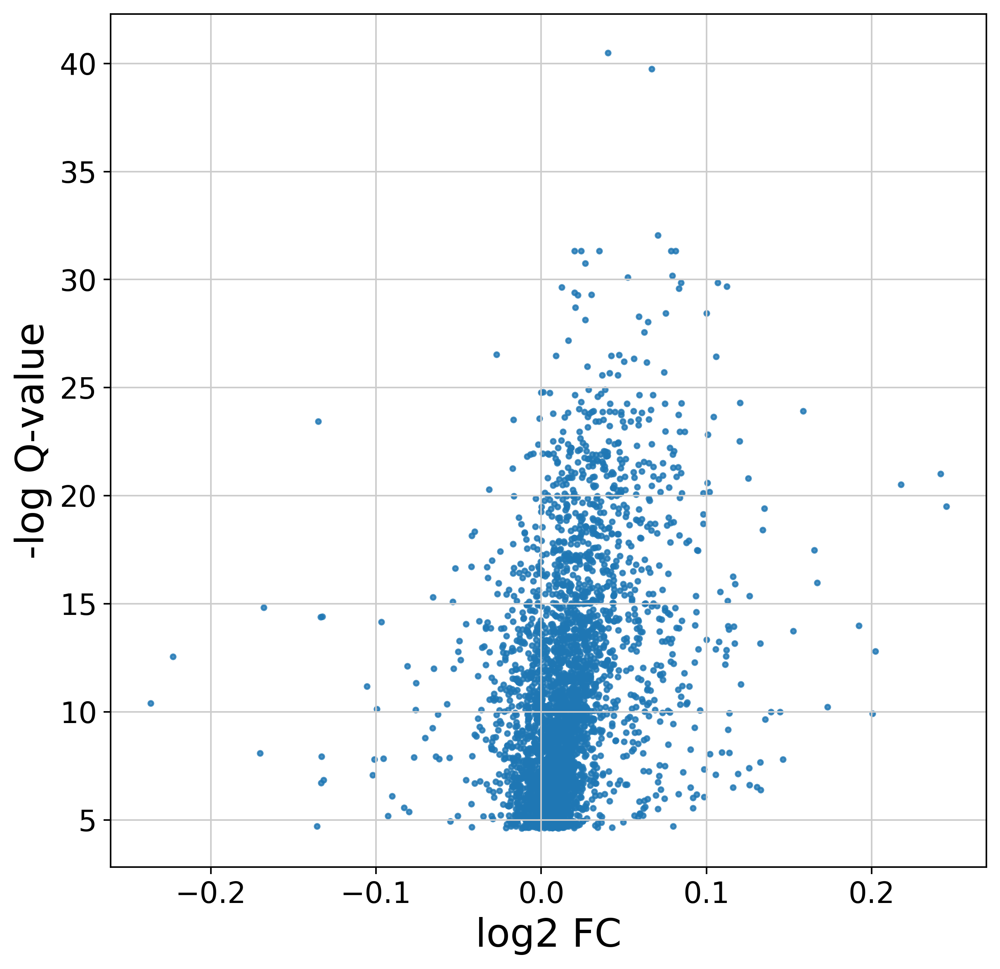

In [82]:
#Volcano plot of results
B_de['-logQ'] = -np.log(B_de['FDR'])
lowqval_de = B_de.loc[B_de['-logQ'] > 200]
other_de = B_de.loc[B_de['-logQ'] < 200]

fig, ax = plt.subplots()
sb.regplot(other_de['coef'], other_de['-logQ'], fit_reg=False, scatter_kws={'s':6})
sb.regplot(lowqval_de['coef'], lowqval_de['-logQ'], fit_reg=False, scatter_kws={'s':6})
ax.set_xlabel("log2 FC", fontsize=20)
ax.set_ylabel("-log Q-value", fontsize=20)
ax.tick_params(labelsize=15)

# Label names and positions
x = [i-0.2 for i in lowqval_de['coef']]
y = [i+10 for i in lowqval_de['-logQ']]
labels = lowqval_de['primerid']

# Show only some labels to avoid overcrowding the figure
to_remove = np.where([i < 500 for i in y])[0]
labels = ["" if i in to_remove else lab for i,lab in enumerate(labels) ]

#Move up two labels
y = [y[i]+10 if txt == 'SNRPC' else y[i] for i,txt in enumerate(labels)]
y = [y[i]+20 if txt == 'ARF5' else y[i] for i,txt in enumerate(labels)]

#Move down one label
y = [y[i]-20 if txt == 'NAA10' else y[i] for i,txt in enumerate(labels)]

for i,txt in enumerate(labels):
    ax.annotate(txt, (x[i], y[i]))
plt.show()

## 3.6.2 Gene set analysis with g:Profiler

For our B cell differential expression data that doesn't make sense because we lack different conditions to test, here is what you typically would do to understand the differential signals in your data (functional enrichment).  Specifically, we are looking for Gene Ontology Biological Process annotations that are enriched in the set of differentially expressed genes.

This analysis is performed with g:profiler, or specifically with Valentine Svensson's python API for the g:profiler webtool. It should be noted that g:profiler's python API is currently being redesigned and thus the old python API (used here) is no longer supported and updated. To use the newest GO data, please check with the g:profiler team.

It is common to do this type of analysis on just the up regulated or just the down regulated genes and not both together. It should be noted that relative over- or under-expression of genes does not have to map to up- or down-regulation of a biological process. For example, relatively lower expression levels of a pathway inhibitor, will result in an up-regulation of the activity of this pathway, while the opposite is true for low expression of a promoter. Thus, a more detailed investigation is generally necessary to conclude the direction of regulation of a process between conditions.

In [83]:
#Interpretation of differentially expressed genes in B cells - g:profiler
gp = GProfiler(return_dataframe=True, user_agent='g:GOSt')

B_enrichment = gp.profile(organism='hsapiens', sources=['GO:BP'], user_threshold=0.05,
                               significance_threshold_method='fdr', 
                               background=adata.var_names.tolist(), 
                               query=B_de['primerid'].tolist())

In [84]:
#B_enrich_results = B_enrichment.sort_values('p.value').iloc[:,[2,3,5,6,11]]
B_enrich_results = B_enrichment.set_index('native').sort_values('p_value').iloc[:,[2,5,7,10,1]]

In [85]:
pd.set_option("display.max_colwidth", 800)
B_enrich_results.iloc[:10,:]

,p_value,term_size,intersection_size,recall,name
native,,,,,
GO:0000377,3.078480e-16,295,176,0.596610,"RNA splicing, via transesterification reactions with bulged adenosine as nucleophile"
GO:0000398,3.078480e-16,295,176,0.596610,"mRNA splicing, via spliceosome"
GO:0043933,3.078480e-16,1424,638,0.448034,protein-containing complex subunit organization
GO:0000375,3.340835e-16,298,177,0.593960,"RNA splicing, via transesterification reactions"
GO:0006955,8.142943e-16,1322,596,0.450832,immune response
GO:0008380,6.053634e-14,373,205,0.549598,RNA splicing
GO:0042773,2.969086e-13,85,66,0.776471,ATP synthesis coupled electron transport
GO:0042775,5.325062e-13,84,65,0.773810,mitochondrial ATP synthesis coupled electron transport
GO:0070125,5.325062e-13,84,65,0.773810,mitochondrial translational elongation


## 3.7 Write to file

In [86]:
#Write to file
adata.write('../PBMC_example.h5ad')

# 4 Summary

In this case study we went through the typical steps of an scRNA-seq data analysis workflow. We started with general preprocessing steps, which included cell and gene quality control, normalization, batch correction, selection of highly variable genes, visualization, and cell cycle scoring. In these steps the overall structure of the data is explored and filtered to produce optimal downstream analysis results. In the downstream scRNA-seq analysis section we then used methods to interpret the data and investigate particular parts of it. These steps included clustering and cluster identification via marker genes, trajectory inference, inferring an abstracted graph to relate clusters and trajectory inference in one visualization, and an example of differential expression although we did not have any experimental conditions to test.

Any individual data analysis script will not always follow all of these steps. For example, trajectory inference may not be relevant where no differentiation processes are captured (this is probably the case with our data). Furthermore, a typical analysis will not always traverse the above steps as linearly as shown here. We have attempted to show this by suggesting how one can move back to data preprocessing to improve trajectory inference or PAGA. Indeed, all downstream analyses may require going back to tweak or add preprocessing steps to improve the downstream analysis results.

A further aspect we stressed in this case study is that one should take care of which stage of data is being used to perform different analysis steps. Uncorrected, normalized data (or raw counts depending on the tool) are generally used for statistical tests where technical covariates such as batch can be included; corrected data should be used to visually compare results as the human eye will not be able to take into account technical differences that confound the comparison. When computing tests such as differential expression or finding marker genes, it is adviseable to use the full data set that is not restricted to find highly variable genes.